# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:03, 54.2MB/s]                            
SVHN Testing Set: 64.3MB [00:01, 51.5MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

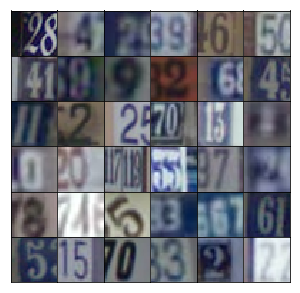

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.6903... Generator Loss: 0.5205
Epoch 1/25... Discriminator Loss: 0.4107... Generator Loss: 1.8738
Epoch 1/25... Discriminator Loss: 0.1852... Generator Loss: 2.4227
Epoch 1/25... Discriminator Loss: 0.1347... Generator Loss: 2.6809
Epoch 1/25... Discriminator Loss: 0.1813... Generator Loss: 2.7213
Epoch 1/25... Discriminator Loss: 0.0806... Generator Loss: 3.7064
Epoch 1/25... Discriminator Loss: 0.2047... Generator Loss: 2.3899
Epoch 1/25... Discriminator Loss: 1.2550... Generator Loss: 0.6966
Epoch 1/25... Discriminator Loss: 0.8180... Generator Loss: 2.2916
Epoch 1/25... Discriminator Loss: 0.9437... Generator Loss: 1.2225


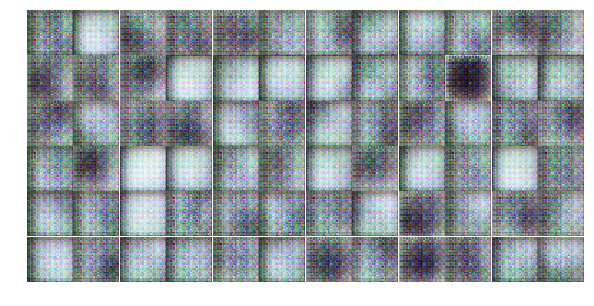

Epoch 1/25... Discriminator Loss: 0.4516... Generator Loss: 1.9207
Epoch 1/25... Discriminator Loss: 0.5029... Generator Loss: 1.7908
Epoch 1/25... Discriminator Loss: 0.4561... Generator Loss: 1.8739
Epoch 1/25... Discriminator Loss: 0.2129... Generator Loss: 2.4005
Epoch 1/25... Discriminator Loss: 0.6459... Generator Loss: 1.2054
Epoch 1/25... Discriminator Loss: 0.3522... Generator Loss: 1.9374
Epoch 1/25... Discriminator Loss: 0.3045... Generator Loss: 2.2734
Epoch 1/25... Discriminator Loss: 0.3403... Generator Loss: 2.4900
Epoch 1/25... Discriminator Loss: 0.7724... Generator Loss: 3.3702
Epoch 1/25... Discriminator Loss: 0.3475... Generator Loss: 2.9208


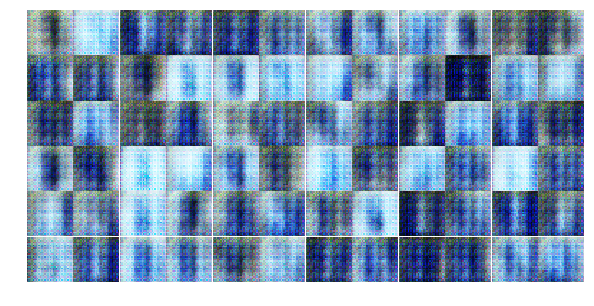

Epoch 1/25... Discriminator Loss: 0.4429... Generator Loss: 1.6898
Epoch 1/25... Discriminator Loss: 0.2295... Generator Loss: 2.9049
Epoch 1/25... Discriminator Loss: 0.7102... Generator Loss: 2.7104
Epoch 1/25... Discriminator Loss: 0.3737... Generator Loss: 2.4568
Epoch 1/25... Discriminator Loss: 0.8350... Generator Loss: 1.0017
Epoch 1/25... Discriminator Loss: 0.9523... Generator Loss: 1.1168
Epoch 1/25... Discriminator Loss: 1.5284... Generator Loss: 0.7467
Epoch 1/25... Discriminator Loss: 1.2123... Generator Loss: 1.1077
Epoch 1/25... Discriminator Loss: 0.7799... Generator Loss: 1.5069
Epoch 1/25... Discriminator Loss: 0.6643... Generator Loss: 1.3578


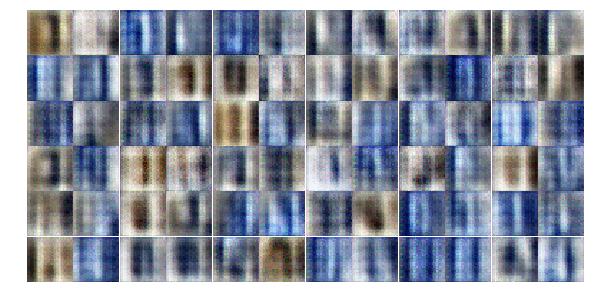

Epoch 1/25... Discriminator Loss: 0.4540... Generator Loss: 1.9570
Epoch 1/25... Discriminator Loss: 0.7340... Generator Loss: 1.0557
Epoch 1/25... Discriminator Loss: 0.5531... Generator Loss: 1.7323
Epoch 1/25... Discriminator Loss: 0.9575... Generator Loss: 0.9334
Epoch 1/25... Discriminator Loss: 0.5899... Generator Loss: 1.2649
Epoch 1/25... Discriminator Loss: 1.1448... Generator Loss: 0.5630
Epoch 1/25... Discriminator Loss: 0.6767... Generator Loss: 1.2467
Epoch 1/25... Discriminator Loss: 0.4582... Generator Loss: 2.7483
Epoch 1/25... Discriminator Loss: 0.4892... Generator Loss: 1.5622
Epoch 1/25... Discriminator Loss: 0.9572... Generator Loss: 0.9757


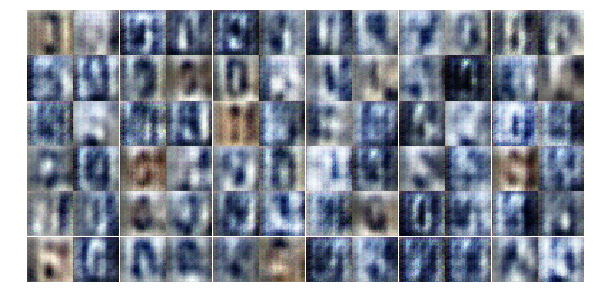

Epoch 1/25... Discriminator Loss: 1.0121... Generator Loss: 0.8330
Epoch 1/25... Discriminator Loss: 1.0720... Generator Loss: 0.9646
Epoch 1/25... Discriminator Loss: 0.5402... Generator Loss: 2.0263
Epoch 1/25... Discriminator Loss: 1.0416... Generator Loss: 0.9505
Epoch 1/25... Discriminator Loss: 0.6834... Generator Loss: 1.7365
Epoch 1/25... Discriminator Loss: 0.9215... Generator Loss: 1.2821
Epoch 1/25... Discriminator Loss: 0.6441... Generator Loss: 1.3713
Epoch 1/25... Discriminator Loss: 0.5657... Generator Loss: 1.7205
Epoch 1/25... Discriminator Loss: 0.7076... Generator Loss: 1.1456
Epoch 1/25... Discriminator Loss: 1.2105... Generator Loss: 1.0402


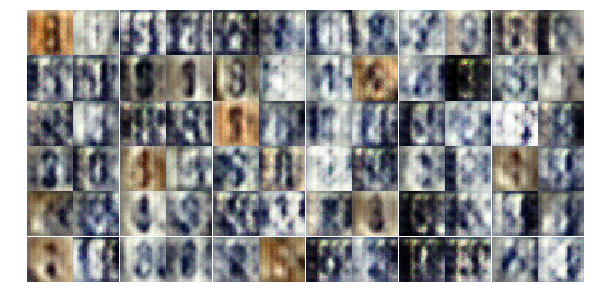

Epoch 1/25... Discriminator Loss: 1.0004... Generator Loss: 0.8163
Epoch 1/25... Discriminator Loss: 0.7812... Generator Loss: 1.0886
Epoch 1/25... Discriminator Loss: 0.7807... Generator Loss: 1.5170
Epoch 1/25... Discriminator Loss: 1.1426... Generator Loss: 0.8114
Epoch 1/25... Discriminator Loss: 0.9225... Generator Loss: 1.4231
Epoch 1/25... Discriminator Loss: 0.6957... Generator Loss: 1.5183
Epoch 1/25... Discriminator Loss: 1.0333... Generator Loss: 1.2804
Epoch 2/25... Discriminator Loss: 1.1940... Generator Loss: 1.0315
Epoch 2/25... Discriminator Loss: 0.5605... Generator Loss: 1.5664
Epoch 2/25... Discriminator Loss: 1.1638... Generator Loss: 0.6207


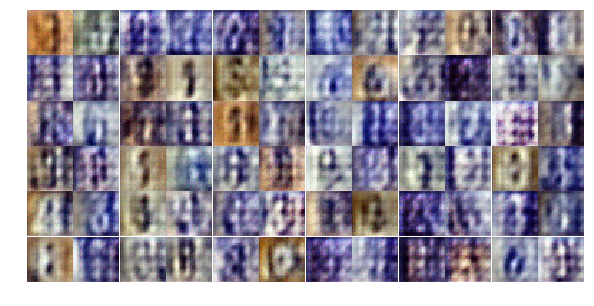

Epoch 2/25... Discriminator Loss: 0.9102... Generator Loss: 1.2558
Epoch 2/25... Discriminator Loss: 0.8071... Generator Loss: 1.6406
Epoch 2/25... Discriminator Loss: 0.9825... Generator Loss: 1.2824
Epoch 2/25... Discriminator Loss: 0.8592... Generator Loss: 1.3483
Epoch 2/25... Discriminator Loss: 0.9385... Generator Loss: 1.3121
Epoch 2/25... Discriminator Loss: 1.0885... Generator Loss: 0.8623
Epoch 2/25... Discriminator Loss: 1.3637... Generator Loss: 1.0087
Epoch 2/25... Discriminator Loss: 1.0369... Generator Loss: 1.3053
Epoch 2/25... Discriminator Loss: 1.2908... Generator Loss: 0.7795
Epoch 2/25... Discriminator Loss: 1.0223... Generator Loss: 1.1436


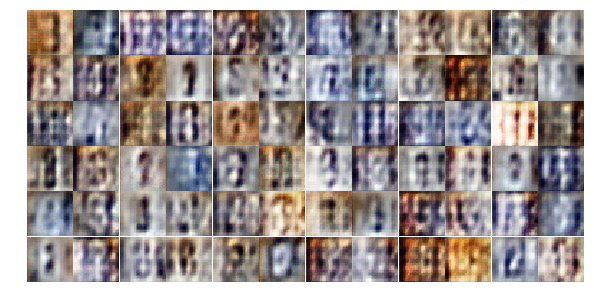

Epoch 2/25... Discriminator Loss: 1.1836... Generator Loss: 0.8479
Epoch 2/25... Discriminator Loss: 1.0348... Generator Loss: 1.0671
Epoch 2/25... Discriminator Loss: 0.7003... Generator Loss: 2.0010
Epoch 2/25... Discriminator Loss: 0.9638... Generator Loss: 1.0462
Epoch 2/25... Discriminator Loss: 0.8248... Generator Loss: 1.2611
Epoch 2/25... Discriminator Loss: 1.5286... Generator Loss: 1.0121
Epoch 2/25... Discriminator Loss: 1.0658... Generator Loss: 0.9509
Epoch 2/25... Discriminator Loss: 0.9989... Generator Loss: 0.8241
Epoch 2/25... Discriminator Loss: 1.1567... Generator Loss: 0.7239
Epoch 2/25... Discriminator Loss: 1.1144... Generator Loss: 0.9444


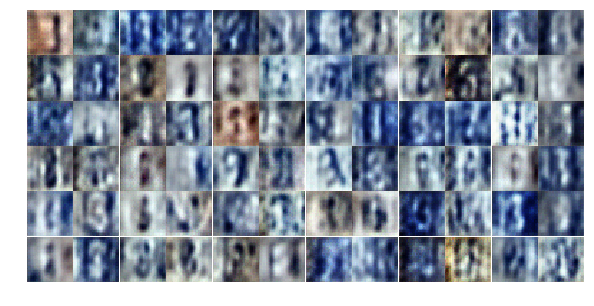

Epoch 2/25... Discriminator Loss: 1.0437... Generator Loss: 0.8368
Epoch 2/25... Discriminator Loss: 0.9774... Generator Loss: 0.9153
Epoch 2/25... Discriminator Loss: 1.0374... Generator Loss: 1.1873
Epoch 2/25... Discriminator Loss: 0.8081... Generator Loss: 1.4647
Epoch 2/25... Discriminator Loss: 1.2103... Generator Loss: 0.9854
Epoch 2/25... Discriminator Loss: 1.0801... Generator Loss: 0.9304
Epoch 2/25... Discriminator Loss: 1.2466... Generator Loss: 0.6601
Epoch 2/25... Discriminator Loss: 1.0300... Generator Loss: 0.7846
Epoch 2/25... Discriminator Loss: 1.3039... Generator Loss: 0.7494
Epoch 2/25... Discriminator Loss: 1.2450... Generator Loss: 0.8030


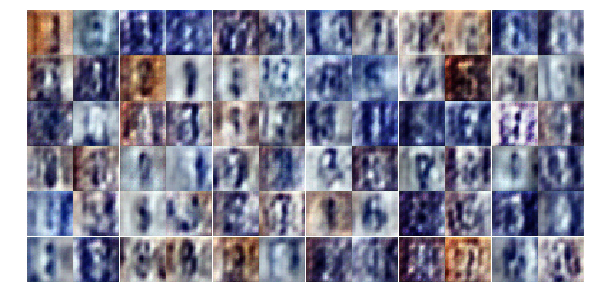

Epoch 2/25... Discriminator Loss: 1.1216... Generator Loss: 0.8549
Epoch 2/25... Discriminator Loss: 0.8039... Generator Loss: 1.4482
Epoch 2/25... Discriminator Loss: 0.9511... Generator Loss: 1.1315
Epoch 2/25... Discriminator Loss: 0.9907... Generator Loss: 0.8568
Epoch 2/25... Discriminator Loss: 1.0169... Generator Loss: 1.1933
Epoch 2/25... Discriminator Loss: 1.4241... Generator Loss: 1.1128
Epoch 2/25... Discriminator Loss: 1.1308... Generator Loss: 0.8751
Epoch 2/25... Discriminator Loss: 0.8839... Generator Loss: 1.7720
Epoch 2/25... Discriminator Loss: 1.5054... Generator Loss: 2.2224
Epoch 2/25... Discriminator Loss: 0.6893... Generator Loss: 1.4683


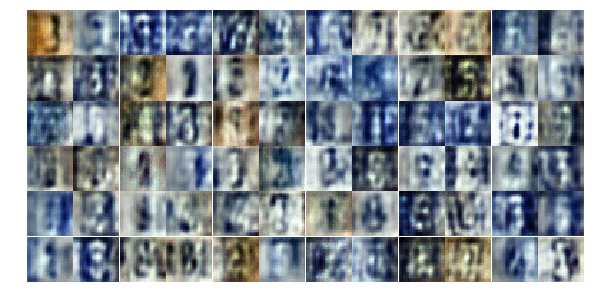

Epoch 2/25... Discriminator Loss: 1.2684... Generator Loss: 0.9840
Epoch 2/25... Discriminator Loss: 1.2265... Generator Loss: 1.1830
Epoch 2/25... Discriminator Loss: 1.1874... Generator Loss: 0.7455
Epoch 2/25... Discriminator Loss: 1.2761... Generator Loss: 0.7418
Epoch 2/25... Discriminator Loss: 1.0156... Generator Loss: 0.8238
Epoch 2/25... Discriminator Loss: 1.7395... Generator Loss: 0.3624
Epoch 2/25... Discriminator Loss: 0.8424... Generator Loss: 1.2710
Epoch 2/25... Discriminator Loss: 0.9715... Generator Loss: 1.7615
Epoch 2/25... Discriminator Loss: 1.0811... Generator Loss: 2.0137
Epoch 2/25... Discriminator Loss: 1.0363... Generator Loss: 0.7175


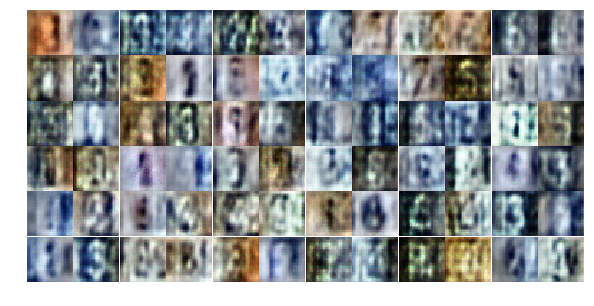

Epoch 2/25... Discriminator Loss: 0.7976... Generator Loss: 1.5807
Epoch 2/25... Discriminator Loss: 1.5208... Generator Loss: 0.8156
Epoch 2/25... Discriminator Loss: 1.6121... Generator Loss: 0.5113
Epoch 2/25... Discriminator Loss: 0.9400... Generator Loss: 0.9449
Epoch 3/25... Discriminator Loss: 0.8149... Generator Loss: 1.3042
Epoch 3/25... Discriminator Loss: 0.9032... Generator Loss: 1.6641
Epoch 3/25... Discriminator Loss: 1.0089... Generator Loss: 1.3582
Epoch 3/25... Discriminator Loss: 0.6150... Generator Loss: 1.4947
Epoch 3/25... Discriminator Loss: 0.5368... Generator Loss: 1.7141
Epoch 3/25... Discriminator Loss: 1.0763... Generator Loss: 1.2140


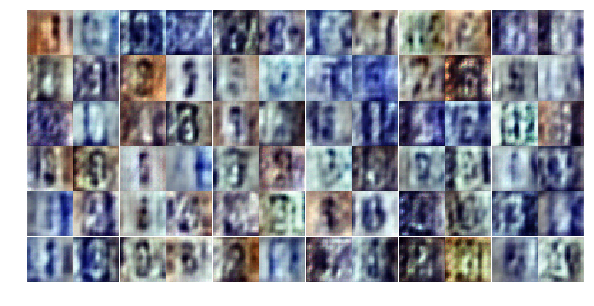

Epoch 3/25... Discriminator Loss: 1.1882... Generator Loss: 0.5174
Epoch 3/25... Discriminator Loss: 0.9017... Generator Loss: 0.9579
Epoch 3/25... Discriminator Loss: 0.7983... Generator Loss: 1.7537
Epoch 3/25... Discriminator Loss: 0.7537... Generator Loss: 0.9398
Epoch 3/25... Discriminator Loss: 0.6076... Generator Loss: 1.3115
Epoch 3/25... Discriminator Loss: 1.1878... Generator Loss: 0.6404
Epoch 3/25... Discriminator Loss: 0.7110... Generator Loss: 1.3576
Epoch 3/25... Discriminator Loss: 0.4402... Generator Loss: 1.4776
Epoch 3/25... Discriminator Loss: 0.4401... Generator Loss: 1.5528
Epoch 3/25... Discriminator Loss: 0.6975... Generator Loss: 1.1078


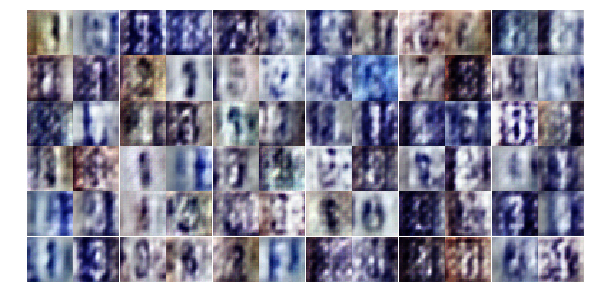

Epoch 3/25... Discriminator Loss: 0.7184... Generator Loss: 2.4252
Epoch 3/25... Discriminator Loss: 0.8818... Generator Loss: 1.0161
Epoch 3/25... Discriminator Loss: 0.8838... Generator Loss: 1.3331
Epoch 3/25... Discriminator Loss: 0.6434... Generator Loss: 1.1990
Epoch 3/25... Discriminator Loss: 0.9214... Generator Loss: 0.7307
Epoch 3/25... Discriminator Loss: 0.7688... Generator Loss: 1.4953
Epoch 3/25... Discriminator Loss: 0.8981... Generator Loss: 1.8755
Epoch 3/25... Discriminator Loss: 0.9582... Generator Loss: 2.1271
Epoch 3/25... Discriminator Loss: 0.5248... Generator Loss: 2.0466
Epoch 3/25... Discriminator Loss: 0.5524... Generator Loss: 2.3519


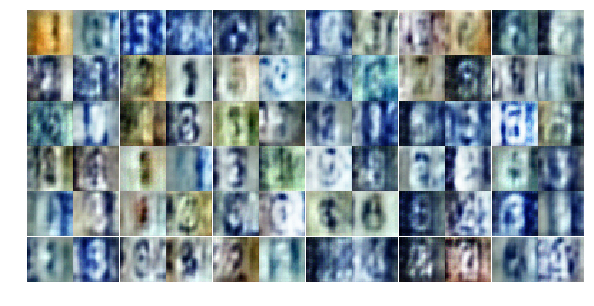

Epoch 3/25... Discriminator Loss: 0.5820... Generator Loss: 1.5710
Epoch 3/25... Discriminator Loss: 0.6632... Generator Loss: 1.3077
Epoch 3/25... Discriminator Loss: 0.7373... Generator Loss: 0.9061
Epoch 3/25... Discriminator Loss: 0.4567... Generator Loss: 2.3618
Epoch 3/25... Discriminator Loss: 1.1187... Generator Loss: 0.5828
Epoch 3/25... Discriminator Loss: 0.4846... Generator Loss: 1.8338
Epoch 3/25... Discriminator Loss: 0.7189... Generator Loss: 1.1625
Epoch 3/25... Discriminator Loss: 0.4588... Generator Loss: 2.2518
Epoch 3/25... Discriminator Loss: 1.5665... Generator Loss: 0.3210
Epoch 3/25... Discriminator Loss: 0.7229... Generator Loss: 1.0324


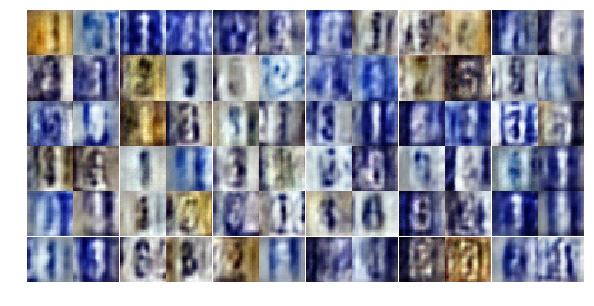

Epoch 3/25... Discriminator Loss: 0.2714... Generator Loss: 2.1521
Epoch 3/25... Discriminator Loss: 0.6317... Generator Loss: 1.0488
Epoch 3/25... Discriminator Loss: 0.4763... Generator Loss: 3.3797
Epoch 3/25... Discriminator Loss: 1.3580... Generator Loss: 0.4486
Epoch 3/25... Discriminator Loss: 0.3218... Generator Loss: 2.4237
Epoch 3/25... Discriminator Loss: 0.4131... Generator Loss: 2.9274
Epoch 3/25... Discriminator Loss: 0.6636... Generator Loss: 1.5297
Epoch 3/25... Discriminator Loss: 0.3302... Generator Loss: 1.8837
Epoch 3/25... Discriminator Loss: 1.6926... Generator Loss: 0.5674
Epoch 3/25... Discriminator Loss: 0.7777... Generator Loss: 1.8850


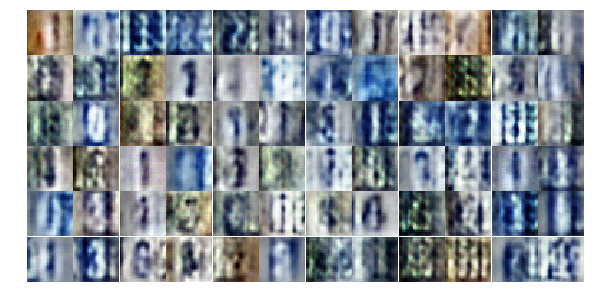

Epoch 3/25... Discriminator Loss: 0.5664... Generator Loss: 2.0629
Epoch 3/25... Discriminator Loss: 0.7668... Generator Loss: 1.4485
Epoch 3/25... Discriminator Loss: 0.2322... Generator Loss: 2.7569
Epoch 3/25... Discriminator Loss: 0.5068... Generator Loss: 1.6871
Epoch 3/25... Discriminator Loss: 0.4731... Generator Loss: 3.2884
Epoch 3/25... Discriminator Loss: 0.4708... Generator Loss: 1.8667
Epoch 3/25... Discriminator Loss: 0.6314... Generator Loss: 1.7295
Epoch 3/25... Discriminator Loss: 0.6331... Generator Loss: 1.2722
Epoch 3/25... Discriminator Loss: 0.4341... Generator Loss: 1.5806
Epoch 3/25... Discriminator Loss: 0.6039... Generator Loss: 1.2116


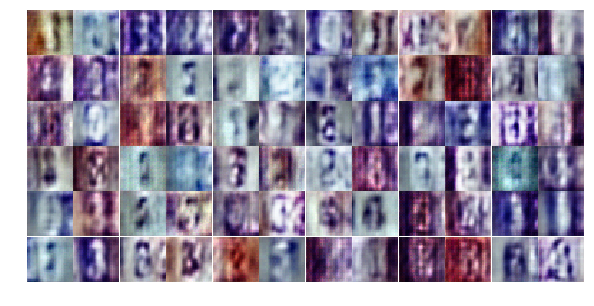

Epoch 3/25... Discriminator Loss: 0.7810... Generator Loss: 1.0908
Epoch 4/25... Discriminator Loss: 1.1750... Generator Loss: 0.5435
Epoch 4/25... Discriminator Loss: 0.7594... Generator Loss: 1.7646
Epoch 4/25... Discriminator Loss: 0.6817... Generator Loss: 0.9742
Epoch 4/25... Discriminator Loss: 0.4635... Generator Loss: 1.5454
Epoch 4/25... Discriminator Loss: 0.7614... Generator Loss: 1.4939
Epoch 4/25... Discriminator Loss: 0.4399... Generator Loss: 2.1399
Epoch 4/25... Discriminator Loss: 0.8709... Generator Loss: 0.9950
Epoch 4/25... Discriminator Loss: 0.7009... Generator Loss: 1.0363
Epoch 4/25... Discriminator Loss: 0.3825... Generator Loss: 1.5692


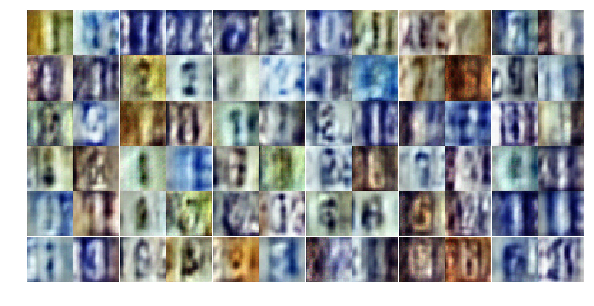

Epoch 4/25... Discriminator Loss: 0.4117... Generator Loss: 2.1271
Epoch 4/25... Discriminator Loss: 1.1727... Generator Loss: 0.5548
Epoch 4/25... Discriminator Loss: 1.1316... Generator Loss: 0.6854
Epoch 4/25... Discriminator Loss: 1.2966... Generator Loss: 0.5621
Epoch 4/25... Discriminator Loss: 0.8027... Generator Loss: 0.9112
Epoch 4/25... Discriminator Loss: 1.2831... Generator Loss: 0.5460
Epoch 4/25... Discriminator Loss: 1.1780... Generator Loss: 0.5901
Epoch 4/25... Discriminator Loss: 0.7541... Generator Loss: 1.0232
Epoch 4/25... Discriminator Loss: 0.6902... Generator Loss: 1.2655
Epoch 4/25... Discriminator Loss: 0.6154... Generator Loss: 1.9701


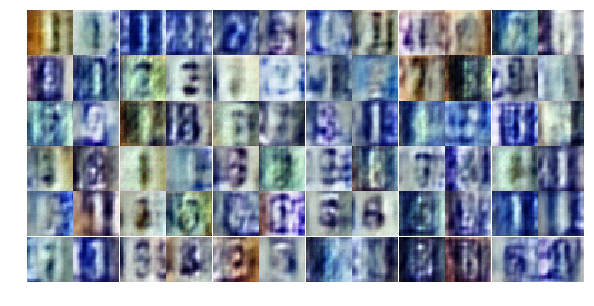

Epoch 4/25... Discriminator Loss: 0.7074... Generator Loss: 1.1659
Epoch 4/25... Discriminator Loss: 0.3560... Generator Loss: 2.0729
Epoch 4/25... Discriminator Loss: 0.7643... Generator Loss: 0.9400
Epoch 4/25... Discriminator Loss: 0.6182... Generator Loss: 1.5172
Epoch 4/25... Discriminator Loss: 0.4092... Generator Loss: 1.9637
Epoch 4/25... Discriminator Loss: 0.7944... Generator Loss: 2.3296
Epoch 4/25... Discriminator Loss: 0.4074... Generator Loss: 1.6036
Epoch 4/25... Discriminator Loss: 0.6590... Generator Loss: 1.0393
Epoch 4/25... Discriminator Loss: 0.5726... Generator Loss: 1.9332
Epoch 4/25... Discriminator Loss: 1.0166... Generator Loss: 0.5954


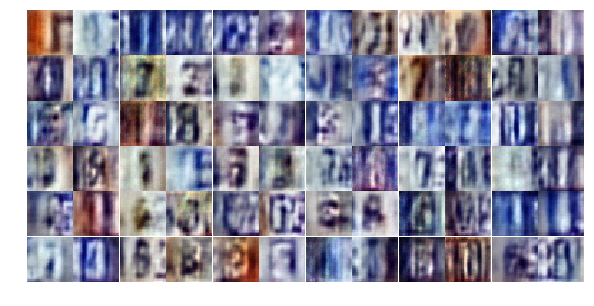

Epoch 4/25... Discriminator Loss: 0.3290... Generator Loss: 2.2277
Epoch 4/25... Discriminator Loss: 0.9229... Generator Loss: 1.1322
Epoch 4/25... Discriminator Loss: 1.0153... Generator Loss: 0.8541
Epoch 4/25... Discriminator Loss: 0.5888... Generator Loss: 1.4232
Epoch 4/25... Discriminator Loss: 0.4070... Generator Loss: 2.4164
Epoch 4/25... Discriminator Loss: 0.4786... Generator Loss: 1.5649
Epoch 4/25... Discriminator Loss: 0.6678... Generator Loss: 2.1110
Epoch 4/25... Discriminator Loss: 1.1654... Generator Loss: 0.5451
Epoch 4/25... Discriminator Loss: 0.5499... Generator Loss: 1.7665
Epoch 4/25... Discriminator Loss: 1.0183... Generator Loss: 0.5724


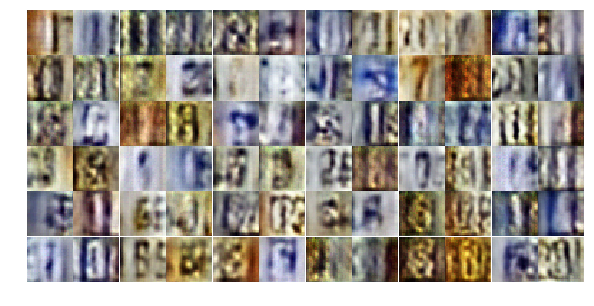

Epoch 4/25... Discriminator Loss: 1.9566... Generator Loss: 0.2233
Epoch 4/25... Discriminator Loss: 0.3627... Generator Loss: 1.8492
Epoch 4/25... Discriminator Loss: 0.5456... Generator Loss: 1.4322
Epoch 4/25... Discriminator Loss: 0.5653... Generator Loss: 1.6335
Epoch 4/25... Discriminator Loss: 0.3451... Generator Loss: 2.2066
Epoch 4/25... Discriminator Loss: 0.7282... Generator Loss: 1.2265
Epoch 4/25... Discriminator Loss: 0.7738... Generator Loss: 0.8195
Epoch 4/25... Discriminator Loss: 0.6354... Generator Loss: 1.5860
Epoch 4/25... Discriminator Loss: 1.2813... Generator Loss: 0.4321
Epoch 4/25... Discriminator Loss: 0.6713... Generator Loss: 1.3111


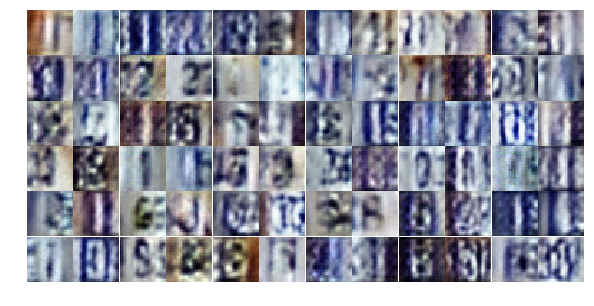

Epoch 4/25... Discriminator Loss: 0.6251... Generator Loss: 1.2809
Epoch 4/25... Discriminator Loss: 0.6376... Generator Loss: 2.4371
Epoch 4/25... Discriminator Loss: 0.5327... Generator Loss: 1.4692
Epoch 4/25... Discriminator Loss: 0.7110... Generator Loss: 1.7028
Epoch 4/25... Discriminator Loss: 0.5115... Generator Loss: 1.5184
Epoch 4/25... Discriminator Loss: 0.5745... Generator Loss: 1.4971
Epoch 4/25... Discriminator Loss: 0.5092... Generator Loss: 1.2922
Epoch 4/25... Discriminator Loss: 0.8862... Generator Loss: 0.7454
Epoch 4/25... Discriminator Loss: 0.4893... Generator Loss: 1.7300
Epoch 5/25... Discriminator Loss: 0.6802... Generator Loss: 1.1045


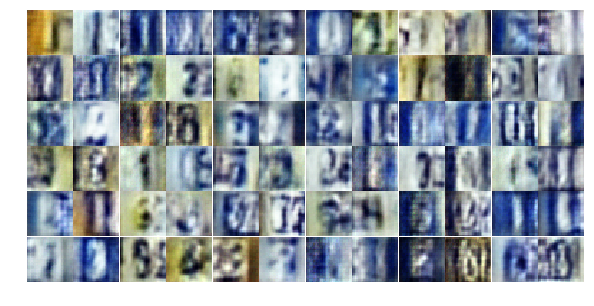

Epoch 5/25... Discriminator Loss: 0.5425... Generator Loss: 1.7900
Epoch 5/25... Discriminator Loss: 0.8016... Generator Loss: 0.9339
Epoch 5/25... Discriminator Loss: 0.7230... Generator Loss: 2.2647
Epoch 5/25... Discriminator Loss: 0.7003... Generator Loss: 0.9051
Epoch 5/25... Discriminator Loss: 0.4430... Generator Loss: 1.5441
Epoch 5/25... Discriminator Loss: 1.6302... Generator Loss: 0.3492
Epoch 5/25... Discriminator Loss: 0.6784... Generator Loss: 1.2336
Epoch 5/25... Discriminator Loss: 0.6005... Generator Loss: 1.9351
Epoch 5/25... Discriminator Loss: 0.5730... Generator Loss: 1.9697
Epoch 5/25... Discriminator Loss: 1.1522... Generator Loss: 1.7891


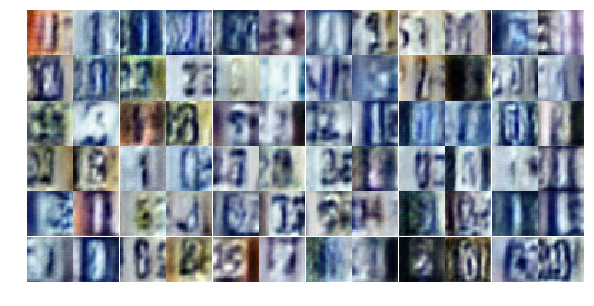

Epoch 5/25... Discriminator Loss: 1.0098... Generator Loss: 0.6403
Epoch 5/25... Discriminator Loss: 0.5081... Generator Loss: 1.5592
Epoch 5/25... Discriminator Loss: 0.4059... Generator Loss: 1.5755
Epoch 5/25... Discriminator Loss: 1.2550... Generator Loss: 0.4793
Epoch 5/25... Discriminator Loss: 0.9064... Generator Loss: 1.2759
Epoch 5/25... Discriminator Loss: 1.0159... Generator Loss: 1.1842
Epoch 5/25... Discriminator Loss: 0.6598... Generator Loss: 1.1167
Epoch 5/25... Discriminator Loss: 0.6683... Generator Loss: 1.1551
Epoch 5/25... Discriminator Loss: 0.7102... Generator Loss: 1.5131
Epoch 5/25... Discriminator Loss: 0.5915... Generator Loss: 1.2318


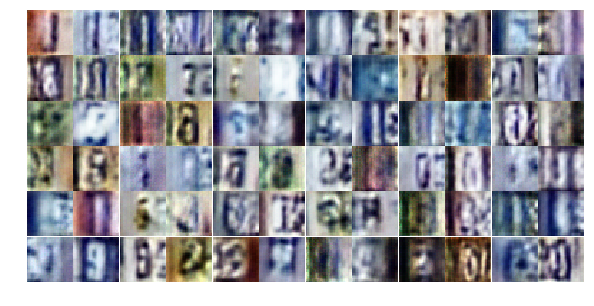

Epoch 5/25... Discriminator Loss: 0.6010... Generator Loss: 1.1280
Epoch 5/25... Discriminator Loss: 0.7983... Generator Loss: 1.4788
Epoch 5/25... Discriminator Loss: 0.4939... Generator Loss: 1.2907
Epoch 5/25... Discriminator Loss: 0.5998... Generator Loss: 1.2656
Epoch 5/25... Discriminator Loss: 1.0186... Generator Loss: 0.6194
Epoch 5/25... Discriminator Loss: 0.8667... Generator Loss: 0.7794
Epoch 5/25... Discriminator Loss: 0.7578... Generator Loss: 0.8725
Epoch 5/25... Discriminator Loss: 1.2256... Generator Loss: 0.5614
Epoch 5/25... Discriminator Loss: 1.0550... Generator Loss: 0.6218
Epoch 5/25... Discriminator Loss: 0.7186... Generator Loss: 0.9283


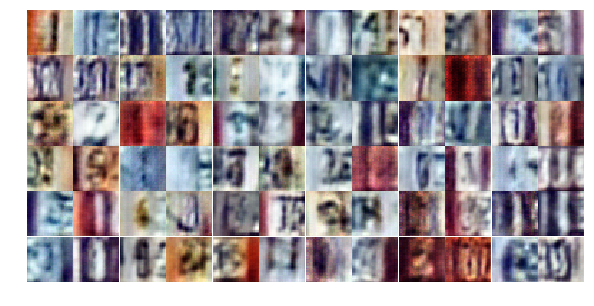

Epoch 5/25... Discriminator Loss: 0.6686... Generator Loss: 1.8370
Epoch 5/25... Discriminator Loss: 0.6468... Generator Loss: 1.1606
Epoch 5/25... Discriminator Loss: 0.8746... Generator Loss: 2.3774
Epoch 5/25... Discriminator Loss: 0.5607... Generator Loss: 1.9146
Epoch 5/25... Discriminator Loss: 0.8221... Generator Loss: 1.7229
Epoch 5/25... Discriminator Loss: 0.6405... Generator Loss: 1.1585
Epoch 5/25... Discriminator Loss: 0.6187... Generator Loss: 1.1283
Epoch 5/25... Discriminator Loss: 0.6707... Generator Loss: 1.0783
Epoch 5/25... Discriminator Loss: 0.5647... Generator Loss: 1.2662
Epoch 5/25... Discriminator Loss: 0.7412... Generator Loss: 1.0523


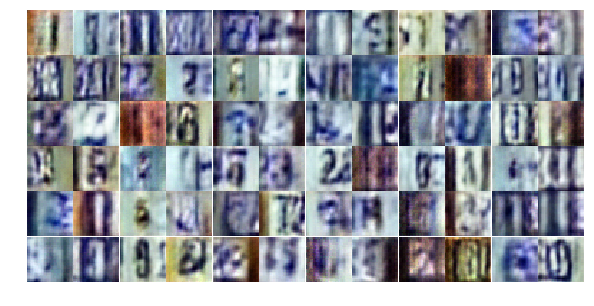

Epoch 5/25... Discriminator Loss: 0.4599... Generator Loss: 1.8652
Epoch 5/25... Discriminator Loss: 0.5396... Generator Loss: 1.3972
Epoch 5/25... Discriminator Loss: 1.1916... Generator Loss: 0.5629
Epoch 5/25... Discriminator Loss: 1.1722... Generator Loss: 2.7109
Epoch 5/25... Discriminator Loss: 0.9412... Generator Loss: 0.9540
Epoch 5/25... Discriminator Loss: 0.8448... Generator Loss: 0.8730
Epoch 5/25... Discriminator Loss: 0.8088... Generator Loss: 1.0004
Epoch 5/25... Discriminator Loss: 0.5772... Generator Loss: 1.1069
Epoch 5/25... Discriminator Loss: 0.5678... Generator Loss: 1.5060
Epoch 5/25... Discriminator Loss: 0.5954... Generator Loss: 1.2884


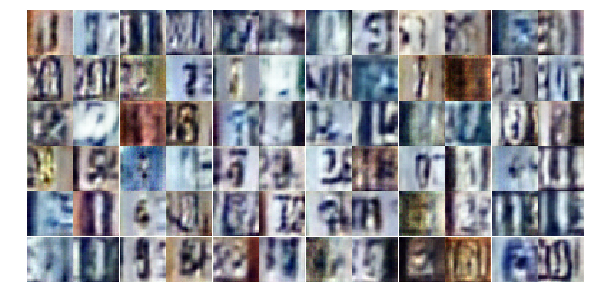

Epoch 5/25... Discriminator Loss: 0.7868... Generator Loss: 1.2766
Epoch 5/25... Discriminator Loss: 0.5871... Generator Loss: 1.2855
Epoch 5/25... Discriminator Loss: 1.0436... Generator Loss: 0.5766
Epoch 5/25... Discriminator Loss: 0.5971... Generator Loss: 1.1426
Epoch 5/25... Discriminator Loss: 0.6049... Generator Loss: 1.4008
Epoch 5/25... Discriminator Loss: 1.0456... Generator Loss: 0.6861
Epoch 6/25... Discriminator Loss: 0.6375... Generator Loss: 1.1483
Epoch 6/25... Discriminator Loss: 0.6187... Generator Loss: 1.3329
Epoch 6/25... Discriminator Loss: 0.8576... Generator Loss: 0.9098
Epoch 6/25... Discriminator Loss: 0.6772... Generator Loss: 1.8460


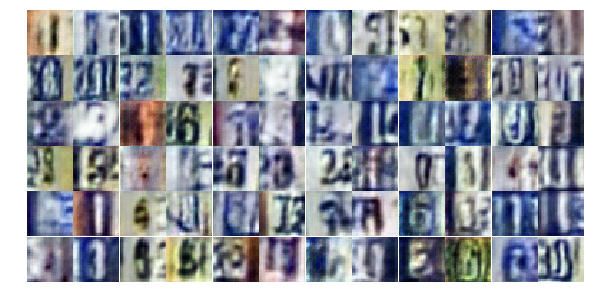

Epoch 6/25... Discriminator Loss: 0.6362... Generator Loss: 1.0578
Epoch 6/25... Discriminator Loss: 0.7323... Generator Loss: 1.2533
Epoch 6/25... Discriminator Loss: 0.6547... Generator Loss: 1.5670
Epoch 6/25... Discriminator Loss: 0.8245... Generator Loss: 1.0264
Epoch 6/25... Discriminator Loss: 1.2107... Generator Loss: 0.5024
Epoch 6/25... Discriminator Loss: 0.4642... Generator Loss: 1.4224
Epoch 6/25... Discriminator Loss: 0.6019... Generator Loss: 1.5757
Epoch 6/25... Discriminator Loss: 0.6938... Generator Loss: 1.4432
Epoch 6/25... Discriminator Loss: 1.0079... Generator Loss: 0.5895
Epoch 6/25... Discriminator Loss: 0.8614... Generator Loss: 0.7857


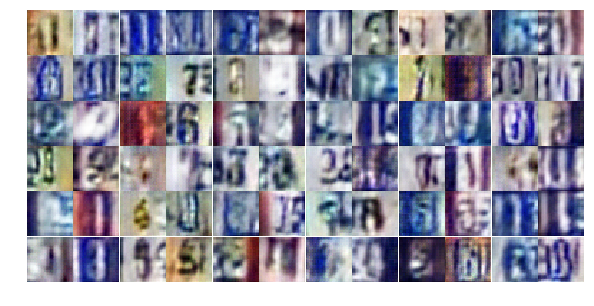

Epoch 6/25... Discriminator Loss: 0.5914... Generator Loss: 1.6816
Epoch 6/25... Discriminator Loss: 1.0682... Generator Loss: 2.2953
Epoch 6/25... Discriminator Loss: 1.0192... Generator Loss: 1.1148
Epoch 6/25... Discriminator Loss: 0.7781... Generator Loss: 0.8013
Epoch 6/25... Discriminator Loss: 0.7338... Generator Loss: 1.5989
Epoch 6/25... Discriminator Loss: 0.6002... Generator Loss: 2.0924
Epoch 6/25... Discriminator Loss: 0.6805... Generator Loss: 1.0795
Epoch 6/25... Discriminator Loss: 0.7228... Generator Loss: 1.4706
Epoch 6/25... Discriminator Loss: 0.5827... Generator Loss: 1.8964
Epoch 6/25... Discriminator Loss: 0.6756... Generator Loss: 1.1285


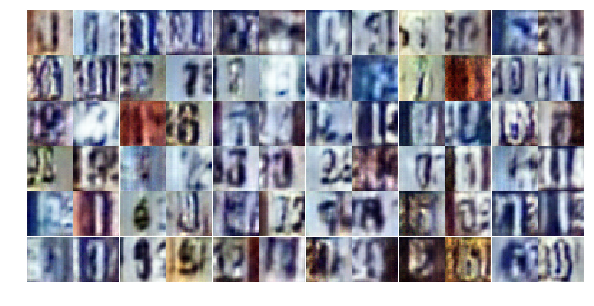

Epoch 6/25... Discriminator Loss: 0.8541... Generator Loss: 0.7618
Epoch 6/25... Discriminator Loss: 0.7282... Generator Loss: 2.7095
Epoch 6/25... Discriminator Loss: 1.4006... Generator Loss: 0.5365
Epoch 6/25... Discriminator Loss: 0.6880... Generator Loss: 1.7221
Epoch 6/25... Discriminator Loss: 0.8499... Generator Loss: 2.0835
Epoch 6/25... Discriminator Loss: 1.3688... Generator Loss: 0.4205
Epoch 6/25... Discriminator Loss: 0.7173... Generator Loss: 0.8898
Epoch 6/25... Discriminator Loss: 0.4703... Generator Loss: 1.3826
Epoch 6/25... Discriminator Loss: 0.5584... Generator Loss: 1.2635
Epoch 6/25... Discriminator Loss: 0.4590... Generator Loss: 1.5039


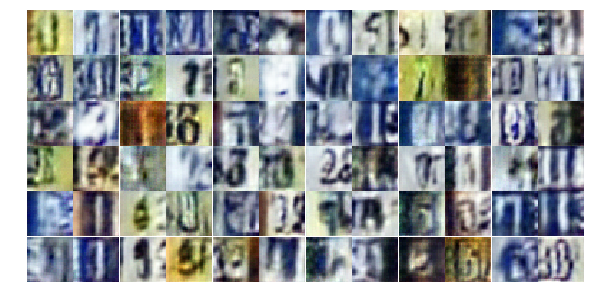

Epoch 6/25... Discriminator Loss: 1.4393... Generator Loss: 0.3602
Epoch 6/25... Discriminator Loss: 0.8933... Generator Loss: 1.3623
Epoch 6/25... Discriminator Loss: 0.8247... Generator Loss: 0.8650
Epoch 6/25... Discriminator Loss: 0.8903... Generator Loss: 1.7979
Epoch 6/25... Discriminator Loss: 1.5364... Generator Loss: 0.3550
Epoch 6/25... Discriminator Loss: 0.6258... Generator Loss: 1.7735
Epoch 6/25... Discriminator Loss: 0.5027... Generator Loss: 1.7407
Epoch 6/25... Discriminator Loss: 0.8064... Generator Loss: 2.5669
Epoch 6/25... Discriminator Loss: 1.1451... Generator Loss: 0.5170
Epoch 6/25... Discriminator Loss: 0.4449... Generator Loss: 1.4943


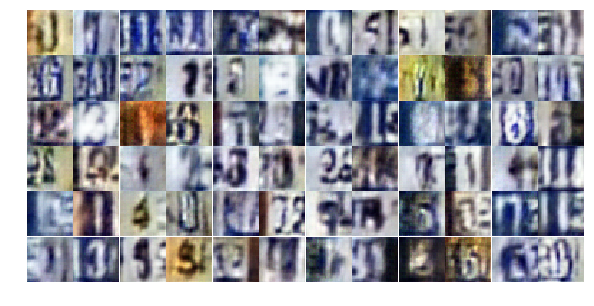

Epoch 6/25... Discriminator Loss: 0.6395... Generator Loss: 1.1875
Epoch 6/25... Discriminator Loss: 0.5758... Generator Loss: 1.8132
Epoch 6/25... Discriminator Loss: 0.9829... Generator Loss: 1.0976
Epoch 6/25... Discriminator Loss: 0.5913... Generator Loss: 1.5158
Epoch 6/25... Discriminator Loss: 0.4251... Generator Loss: 1.7355
Epoch 6/25... Discriminator Loss: 0.5681... Generator Loss: 1.3097
Epoch 6/25... Discriminator Loss: 0.9156... Generator Loss: 0.6828
Epoch 6/25... Discriminator Loss: 0.8387... Generator Loss: 0.7926
Epoch 6/25... Discriminator Loss: 1.4393... Generator Loss: 3.4700
Epoch 6/25... Discriminator Loss: 1.8296... Generator Loss: 0.2347


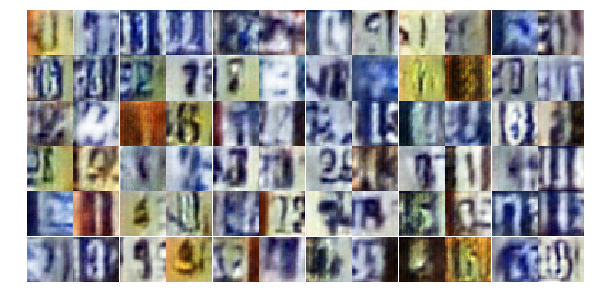

Epoch 6/25... Discriminator Loss: 0.6448... Generator Loss: 1.3634
Epoch 6/25... Discriminator Loss: 0.3256... Generator Loss: 2.2593
Epoch 6/25... Discriminator Loss: 0.6884... Generator Loss: 1.2554
Epoch 7/25... Discriminator Loss: 0.6803... Generator Loss: 1.2038
Epoch 7/25... Discriminator Loss: 0.6401... Generator Loss: 1.1165
Epoch 7/25... Discriminator Loss: 0.7502... Generator Loss: 0.8942
Epoch 7/25... Discriminator Loss: 0.3856... Generator Loss: 1.8454
Epoch 7/25... Discriminator Loss: 0.4683... Generator Loss: 1.6632
Epoch 7/25... Discriminator Loss: 0.5749... Generator Loss: 1.4705
Epoch 7/25... Discriminator Loss: 0.6582... Generator Loss: 1.9637


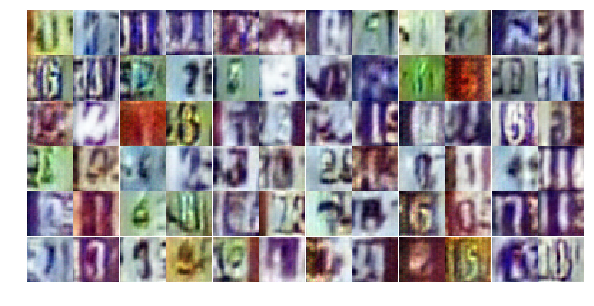

Epoch 7/25... Discriminator Loss: 1.2678... Generator Loss: 3.6635
Epoch 7/25... Discriminator Loss: 1.1078... Generator Loss: 0.9300
Epoch 7/25... Discriminator Loss: 0.8284... Generator Loss: 0.8304
Epoch 7/25... Discriminator Loss: 0.7549... Generator Loss: 1.1996
Epoch 7/25... Discriminator Loss: 0.5288... Generator Loss: 1.2623
Epoch 7/25... Discriminator Loss: 0.5855... Generator Loss: 1.1704
Epoch 7/25... Discriminator Loss: 0.8746... Generator Loss: 2.0756
Epoch 7/25... Discriminator Loss: 0.5030... Generator Loss: 1.5167
Epoch 7/25... Discriminator Loss: 0.4682... Generator Loss: 2.1910
Epoch 7/25... Discriminator Loss: 0.6391... Generator Loss: 1.5457


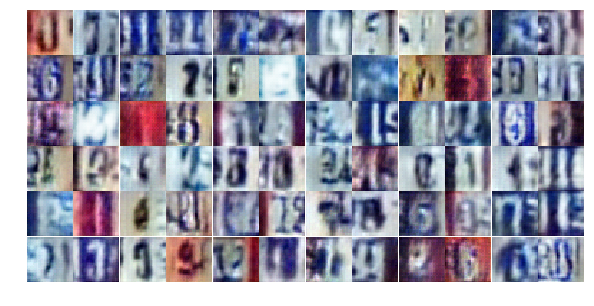

Epoch 7/25... Discriminator Loss: 0.7466... Generator Loss: 0.9699
Epoch 7/25... Discriminator Loss: 0.2446... Generator Loss: 2.3397
Epoch 7/25... Discriminator Loss: 0.6863... Generator Loss: 1.1876
Epoch 7/25... Discriminator Loss: 0.7427... Generator Loss: 0.9249
Epoch 7/25... Discriminator Loss: 0.6462... Generator Loss: 1.1304
Epoch 7/25... Discriminator Loss: 0.4934... Generator Loss: 1.4350
Epoch 7/25... Discriminator Loss: 0.5363... Generator Loss: 1.2764
Epoch 7/25... Discriminator Loss: 1.3252... Generator Loss: 0.4156
Epoch 7/25... Discriminator Loss: 0.3699... Generator Loss: 1.8182
Epoch 7/25... Discriminator Loss: 0.5230... Generator Loss: 2.1024


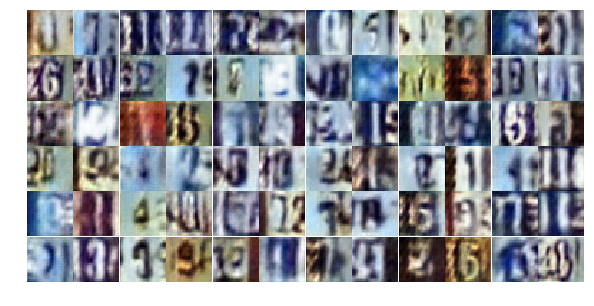

Epoch 7/25... Discriminator Loss: 0.5471... Generator Loss: 1.2434
Epoch 7/25... Discriminator Loss: 0.7627... Generator Loss: 0.8472
Epoch 7/25... Discriminator Loss: 0.5380... Generator Loss: 1.2639
Epoch 7/25... Discriminator Loss: 0.8141... Generator Loss: 1.3605
Epoch 7/25... Discriminator Loss: 0.7312... Generator Loss: 0.9945
Epoch 7/25... Discriminator Loss: 1.0572... Generator Loss: 0.6047
Epoch 7/25... Discriminator Loss: 0.8200... Generator Loss: 0.8499
Epoch 7/25... Discriminator Loss: 0.7037... Generator Loss: 1.0934
Epoch 7/25... Discriminator Loss: 1.5241... Generator Loss: 0.3304
Epoch 7/25... Discriminator Loss: 0.4482... Generator Loss: 1.5639


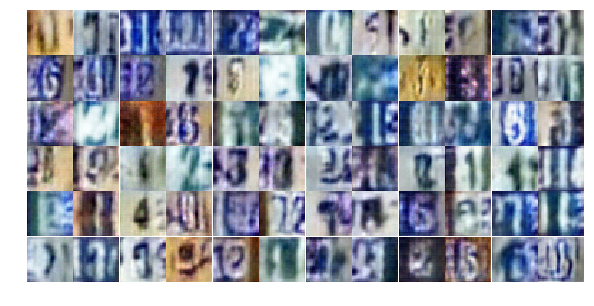

Epoch 7/25... Discriminator Loss: 0.7712... Generator Loss: 1.0194
Epoch 7/25... Discriminator Loss: 0.7065... Generator Loss: 1.7870
Epoch 7/25... Discriminator Loss: 0.4833... Generator Loss: 1.8423
Epoch 7/25... Discriminator Loss: 0.9395... Generator Loss: 0.6751
Epoch 7/25... Discriminator Loss: 0.6535... Generator Loss: 1.2250
Epoch 7/25... Discriminator Loss: 0.6340... Generator Loss: 1.1229
Epoch 7/25... Discriminator Loss: 0.6528... Generator Loss: 1.0123
Epoch 7/25... Discriminator Loss: 0.6956... Generator Loss: 1.1362
Epoch 7/25... Discriminator Loss: 0.3928... Generator Loss: 2.9318
Epoch 7/25... Discriminator Loss: 0.8032... Generator Loss: 0.8755


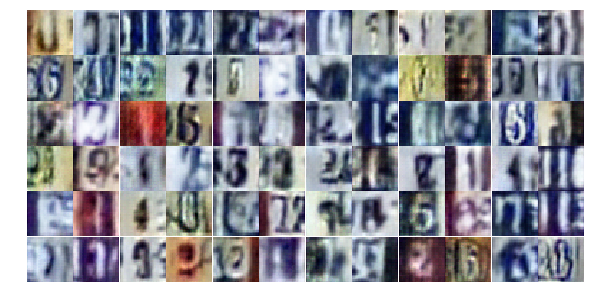

Epoch 7/25... Discriminator Loss: 0.6531... Generator Loss: 1.0862
Epoch 7/25... Discriminator Loss: 0.4624... Generator Loss: 1.6326
Epoch 7/25... Discriminator Loss: 0.7930... Generator Loss: 2.3935
Epoch 7/25... Discriminator Loss: 0.7047... Generator Loss: 1.0109
Epoch 7/25... Discriminator Loss: 0.7853... Generator Loss: 0.8154
Epoch 7/25... Discriminator Loss: 0.8126... Generator Loss: 1.0452
Epoch 7/25... Discriminator Loss: 1.1362... Generator Loss: 0.5313
Epoch 7/25... Discriminator Loss: 0.6163... Generator Loss: 1.4008
Epoch 7/25... Discriminator Loss: 0.9805... Generator Loss: 0.7221
Epoch 7/25... Discriminator Loss: 0.4774... Generator Loss: 1.2904


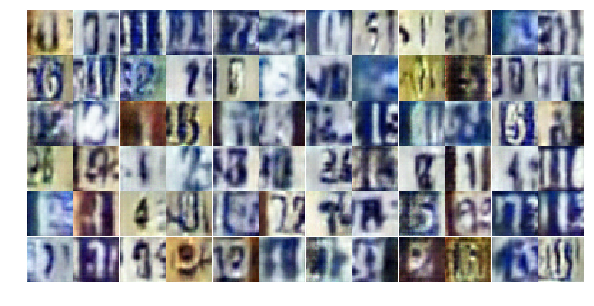

Epoch 7/25... Discriminator Loss: 0.5499... Generator Loss: 2.2634
Epoch 8/25... Discriminator Loss: 0.4880... Generator Loss: 1.5882
Epoch 8/25... Discriminator Loss: 0.9016... Generator Loss: 0.7112
Epoch 8/25... Discriminator Loss: 0.7382... Generator Loss: 0.9811
Epoch 8/25... Discriminator Loss: 0.6068... Generator Loss: 1.6614
Epoch 8/25... Discriminator Loss: 0.9686... Generator Loss: 0.7037
Epoch 8/25... Discriminator Loss: 0.9686... Generator Loss: 0.6814
Epoch 8/25... Discriminator Loss: 0.3905... Generator Loss: 1.8056
Epoch 8/25... Discriminator Loss: 0.7882... Generator Loss: 1.1848
Epoch 8/25... Discriminator Loss: 0.5942... Generator Loss: 1.1917


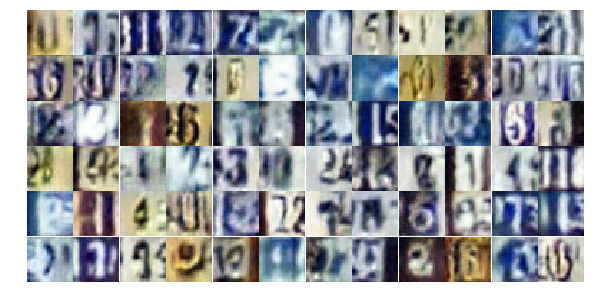

Epoch 8/25... Discriminator Loss: 0.3270... Generator Loss: 2.1129
Epoch 8/25... Discriminator Loss: 0.5237... Generator Loss: 1.2263
Epoch 8/25... Discriminator Loss: 0.8184... Generator Loss: 0.8631
Epoch 8/25... Discriminator Loss: 0.4527... Generator Loss: 2.4819
Epoch 8/25... Discriminator Loss: 0.8674... Generator Loss: 0.7843
Epoch 8/25... Discriminator Loss: 0.6210... Generator Loss: 1.6760
Epoch 8/25... Discriminator Loss: 0.5411... Generator Loss: 1.8040
Epoch 8/25... Discriminator Loss: 0.5595... Generator Loss: 1.5890
Epoch 8/25... Discriminator Loss: 0.5528... Generator Loss: 1.1936
Epoch 8/25... Discriminator Loss: 1.0347... Generator Loss: 0.6349


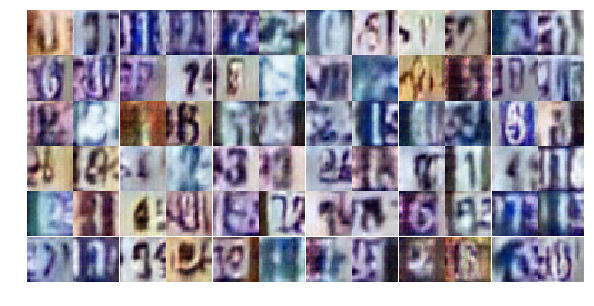

Epoch 8/25... Discriminator Loss: 0.6303... Generator Loss: 1.3598
Epoch 8/25... Discriminator Loss: 0.5274... Generator Loss: 1.4632
Epoch 8/25... Discriminator Loss: 0.6719... Generator Loss: 1.2664
Epoch 8/25... Discriminator Loss: 0.7752... Generator Loss: 1.2167
Epoch 8/25... Discriminator Loss: 0.4220... Generator Loss: 1.8805
Epoch 8/25... Discriminator Loss: 0.5110... Generator Loss: 1.5991
Epoch 8/25... Discriminator Loss: 0.6646... Generator Loss: 1.3877
Epoch 8/25... Discriminator Loss: 0.4445... Generator Loss: 1.3312
Epoch 8/25... Discriminator Loss: 0.6497... Generator Loss: 2.4765
Epoch 8/25... Discriminator Loss: 0.8269... Generator Loss: 0.8717


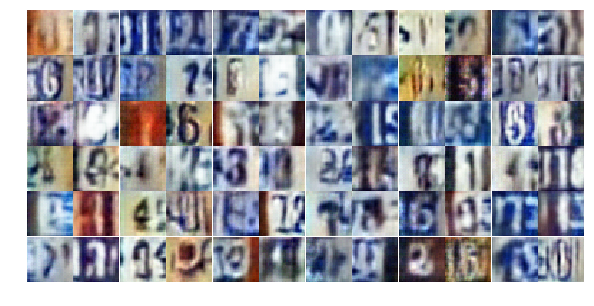

Epoch 8/25... Discriminator Loss: 0.7889... Generator Loss: 1.0880
Epoch 8/25... Discriminator Loss: 0.8607... Generator Loss: 0.8377
Epoch 8/25... Discriminator Loss: 0.7177... Generator Loss: 0.9609
Epoch 8/25... Discriminator Loss: 0.5744... Generator Loss: 1.1728
Epoch 8/25... Discriminator Loss: 0.8193... Generator Loss: 0.7704
Epoch 8/25... Discriminator Loss: 0.4902... Generator Loss: 1.3157
Epoch 8/25... Discriminator Loss: 0.4946... Generator Loss: 1.4311
Epoch 8/25... Discriminator Loss: 0.6746... Generator Loss: 1.1964
Epoch 8/25... Discriminator Loss: 0.5631... Generator Loss: 1.2167
Epoch 8/25... Discriminator Loss: 0.7396... Generator Loss: 0.8648


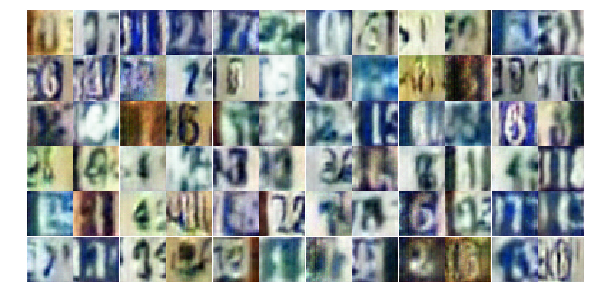

Epoch 8/25... Discriminator Loss: 0.2837... Generator Loss: 2.1825
Epoch 8/25... Discriminator Loss: 1.7112... Generator Loss: 0.2665
Epoch 8/25... Discriminator Loss: 0.3993... Generator Loss: 1.4764
Epoch 8/25... Discriminator Loss: 0.5041... Generator Loss: 1.2504
Epoch 8/25... Discriminator Loss: 2.0802... Generator Loss: 3.7466
Epoch 8/25... Discriminator Loss: 1.6216... Generator Loss: 0.3691
Epoch 8/25... Discriminator Loss: 0.5106... Generator Loss: 1.4350
Epoch 8/25... Discriminator Loss: 0.4867... Generator Loss: 1.4064
Epoch 8/25... Discriminator Loss: 0.5617... Generator Loss: 1.3014
Epoch 8/25... Discriminator Loss: 0.5334... Generator Loss: 1.7161


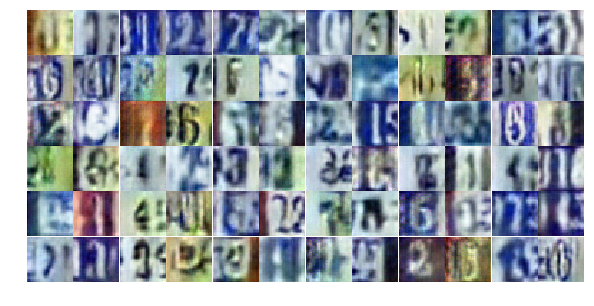

Epoch 8/25... Discriminator Loss: 0.4623... Generator Loss: 1.7354
Epoch 8/25... Discriminator Loss: 0.5789... Generator Loss: 1.3637
Epoch 8/25... Discriminator Loss: 0.9378... Generator Loss: 2.9647
Epoch 8/25... Discriminator Loss: 1.1483... Generator Loss: 0.5137
Epoch 8/25... Discriminator Loss: 0.2701... Generator Loss: 2.1165
Epoch 8/25... Discriminator Loss: 0.7322... Generator Loss: 1.0683
Epoch 8/25... Discriminator Loss: 0.5426... Generator Loss: 1.3190
Epoch 8/25... Discriminator Loss: 0.4135... Generator Loss: 1.9702
Epoch 9/25... Discriminator Loss: 0.7871... Generator Loss: 1.4140
Epoch 9/25... Discriminator Loss: 0.8189... Generator Loss: 0.8016


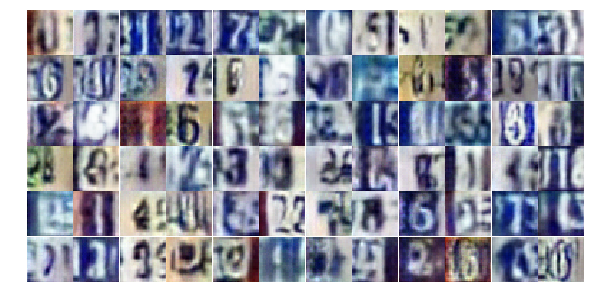

Epoch 9/25... Discriminator Loss: 0.6214... Generator Loss: 1.1065
Epoch 9/25... Discriminator Loss: 0.5682... Generator Loss: 1.1433
Epoch 9/25... Discriminator Loss: 0.6481... Generator Loss: 1.0827
Epoch 9/25... Discriminator Loss: 0.3714... Generator Loss: 1.6900
Epoch 9/25... Discriminator Loss: 1.1203... Generator Loss: 0.5463
Epoch 9/25... Discriminator Loss: 0.4979... Generator Loss: 1.9238
Epoch 9/25... Discriminator Loss: 0.7507... Generator Loss: 1.2649
Epoch 9/25... Discriminator Loss: 0.5770... Generator Loss: 1.2577
Epoch 9/25... Discriminator Loss: 1.0409... Generator Loss: 0.5748
Epoch 9/25... Discriminator Loss: 0.7207... Generator Loss: 1.1059


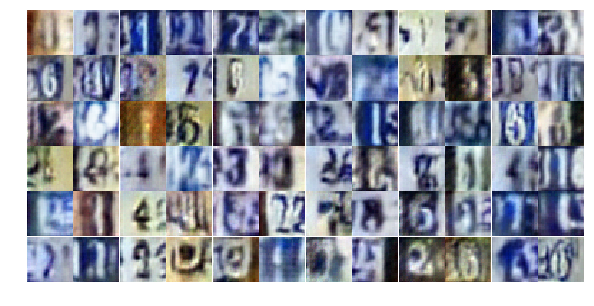

Epoch 9/25... Discriminator Loss: 0.8785... Generator Loss: 0.8250
Epoch 9/25... Discriminator Loss: 0.5978... Generator Loss: 1.4859
Epoch 9/25... Discriminator Loss: 0.5649... Generator Loss: 1.4822
Epoch 9/25... Discriminator Loss: 0.6136... Generator Loss: 1.0750
Epoch 9/25... Discriminator Loss: 0.5221... Generator Loss: 1.3144
Epoch 9/25... Discriminator Loss: 0.7657... Generator Loss: 0.8310
Epoch 9/25... Discriminator Loss: 1.2861... Generator Loss: 0.4254
Epoch 9/25... Discriminator Loss: 0.6545... Generator Loss: 1.2795
Epoch 9/25... Discriminator Loss: 1.2481... Generator Loss: 0.4669
Epoch 9/25... Discriminator Loss: 0.8791... Generator Loss: 0.7119


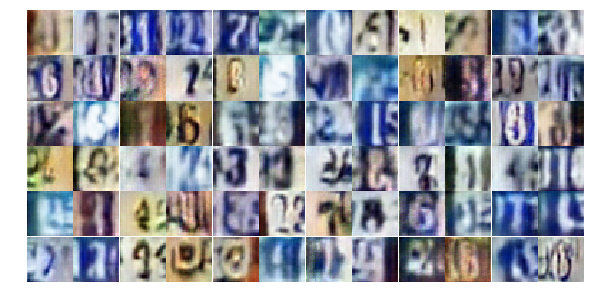

Epoch 9/25... Discriminator Loss: 0.7412... Generator Loss: 1.0766
Epoch 9/25... Discriminator Loss: 0.6263... Generator Loss: 1.1561
Epoch 9/25... Discriminator Loss: 0.6049... Generator Loss: 1.1295
Epoch 9/25... Discriminator Loss: 0.6354... Generator Loss: 1.0833
Epoch 9/25... Discriminator Loss: 0.7070... Generator Loss: 2.1254
Epoch 9/25... Discriminator Loss: 0.6228... Generator Loss: 2.3651
Epoch 9/25... Discriminator Loss: 0.7988... Generator Loss: 1.1119
Epoch 9/25... Discriminator Loss: 0.5768... Generator Loss: 2.4509
Epoch 9/25... Discriminator Loss: 0.6567... Generator Loss: 1.0468
Epoch 9/25... Discriminator Loss: 0.5665... Generator Loss: 1.2412


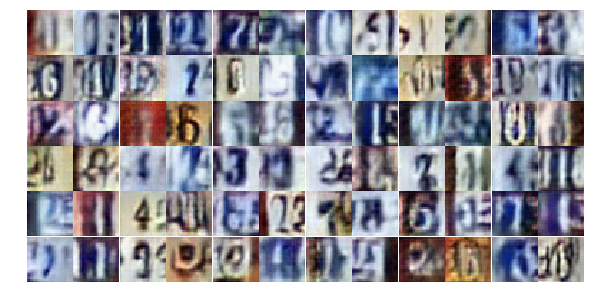

Epoch 9/25... Discriminator Loss: 0.5081... Generator Loss: 1.2632
Epoch 9/25... Discriminator Loss: 0.5133... Generator Loss: 1.4022
Epoch 9/25... Discriminator Loss: 0.4331... Generator Loss: 2.0076
Epoch 9/25... Discriminator Loss: 0.7004... Generator Loss: 1.0596
Epoch 9/25... Discriminator Loss: 0.7805... Generator Loss: 1.0591
Epoch 9/25... Discriminator Loss: 0.5335... Generator Loss: 1.5778
Epoch 9/25... Discriminator Loss: 0.4401... Generator Loss: 1.7679
Epoch 9/25... Discriminator Loss: 0.2368... Generator Loss: 2.2533
Epoch 9/25... Discriminator Loss: 0.9317... Generator Loss: 0.7288
Epoch 9/25... Discriminator Loss: 0.5319... Generator Loss: 1.2283


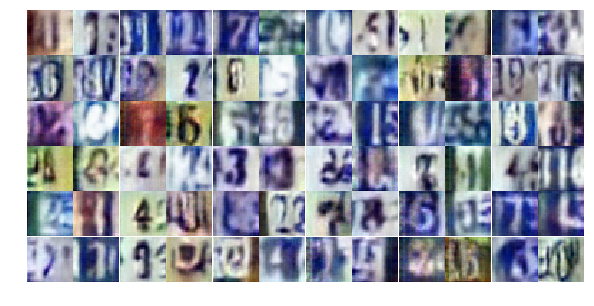

Epoch 9/25... Discriminator Loss: 0.7065... Generator Loss: 0.9266
Epoch 9/25... Discriminator Loss: 0.6388... Generator Loss: 1.0143
Epoch 9/25... Discriminator Loss: 0.6939... Generator Loss: 3.3207
Epoch 9/25... Discriminator Loss: 0.6068... Generator Loss: 1.8593
Epoch 9/25... Discriminator Loss: 0.5142... Generator Loss: 1.4548
Epoch 9/25... Discriminator Loss: 1.1478... Generator Loss: 0.5999
Epoch 9/25... Discriminator Loss: 0.5805... Generator Loss: 1.4174
Epoch 9/25... Discriminator Loss: 0.9400... Generator Loss: 0.6335
Epoch 9/25... Discriminator Loss: 0.4340... Generator Loss: 1.6050
Epoch 9/25... Discriminator Loss: 0.5235... Generator Loss: 1.9919


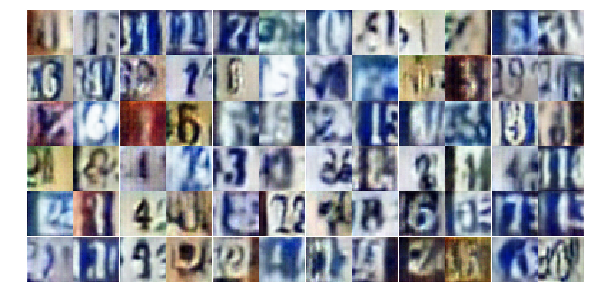

Epoch 9/25... Discriminator Loss: 0.6292... Generator Loss: 1.0207
Epoch 9/25... Discriminator Loss: 0.6753... Generator Loss: 1.3599
Epoch 9/25... Discriminator Loss: 0.6023... Generator Loss: 1.0756
Epoch 9/25... Discriminator Loss: 1.9390... Generator Loss: 0.2173
Epoch 9/25... Discriminator Loss: 1.5045... Generator Loss: 0.4154
Epoch 10/25... Discriminator Loss: 0.7224... Generator Loss: 1.2390
Epoch 10/25... Discriminator Loss: 0.6410... Generator Loss: 1.1215
Epoch 10/25... Discriminator Loss: 0.5810... Generator Loss: 1.1598
Epoch 10/25... Discriminator Loss: 0.8751... Generator Loss: 0.8075
Epoch 10/25... Discriminator Loss: 1.1667... Generator Loss: 0.4930


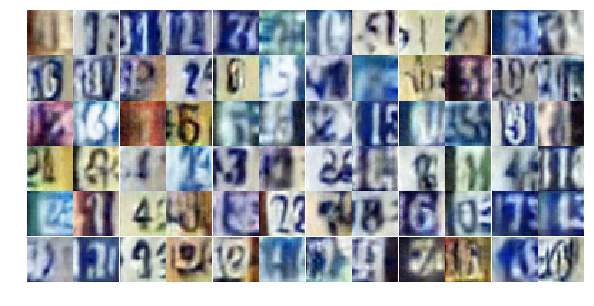

Epoch 10/25... Discriminator Loss: 0.6818... Generator Loss: 0.9988
Epoch 10/25... Discriminator Loss: 0.5675... Generator Loss: 2.6388
Epoch 10/25... Discriminator Loss: 0.6875... Generator Loss: 1.1911
Epoch 10/25... Discriminator Loss: 0.7483... Generator Loss: 0.9327
Epoch 10/25... Discriminator Loss: 0.5080... Generator Loss: 1.3370
Epoch 10/25... Discriminator Loss: 0.6548... Generator Loss: 1.3230
Epoch 10/25... Discriminator Loss: 0.5510... Generator Loss: 1.1363
Epoch 10/25... Discriminator Loss: 0.8671... Generator Loss: 0.8091
Epoch 10/25... Discriminator Loss: 1.1446... Generator Loss: 0.5599
Epoch 10/25... Discriminator Loss: 0.6615... Generator Loss: 1.2690


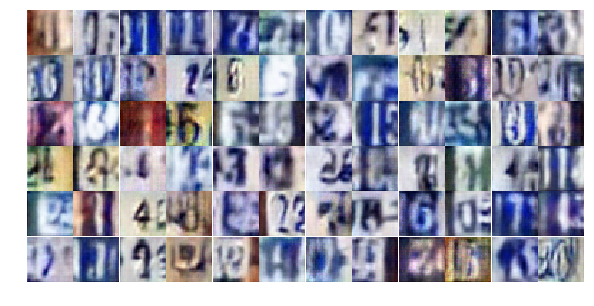

Epoch 10/25... Discriminator Loss: 0.6915... Generator Loss: 1.1318
Epoch 10/25... Discriminator Loss: 0.8809... Generator Loss: 0.7542
Epoch 10/25... Discriminator Loss: 0.6707... Generator Loss: 1.2164
Epoch 10/25... Discriminator Loss: 0.9007... Generator Loss: 0.7400
Epoch 10/25... Discriminator Loss: 0.5946... Generator Loss: 1.6210
Epoch 10/25... Discriminator Loss: 0.7442... Generator Loss: 0.8693
Epoch 10/25... Discriminator Loss: 0.5836... Generator Loss: 1.3000
Epoch 10/25... Discriminator Loss: 0.5809... Generator Loss: 1.2964
Epoch 10/25... Discriminator Loss: 0.5707... Generator Loss: 1.2225
Epoch 10/25... Discriminator Loss: 0.4817... Generator Loss: 2.5326


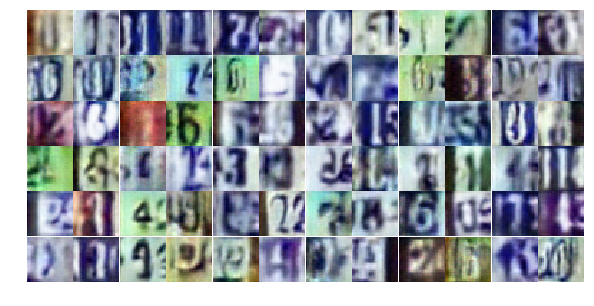

Epoch 10/25... Discriminator Loss: 1.2628... Generator Loss: 0.4387
Epoch 10/25... Discriminator Loss: 0.6189... Generator Loss: 1.2739
Epoch 10/25... Discriminator Loss: 0.4531... Generator Loss: 1.4770
Epoch 10/25... Discriminator Loss: 0.4891... Generator Loss: 1.6412
Epoch 10/25... Discriminator Loss: 1.2898... Generator Loss: 0.4163
Epoch 10/25... Discriminator Loss: 0.5403... Generator Loss: 1.4983
Epoch 10/25... Discriminator Loss: 0.2947... Generator Loss: 1.8048
Epoch 10/25... Discriminator Loss: 0.5976... Generator Loss: 1.2138
Epoch 10/25... Discriminator Loss: 0.4044... Generator Loss: 1.8005
Epoch 10/25... Discriminator Loss: 0.5479... Generator Loss: 2.1586


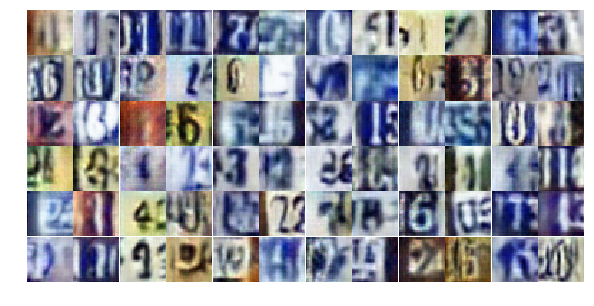

Epoch 10/25... Discriminator Loss: 0.6765... Generator Loss: 1.1440
Epoch 10/25... Discriminator Loss: 0.8973... Generator Loss: 0.7456
Epoch 10/25... Discriminator Loss: 0.7691... Generator Loss: 2.9715
Epoch 10/25... Discriminator Loss: 0.4442... Generator Loss: 1.4831
Epoch 10/25... Discriminator Loss: 0.5473... Generator Loss: 1.1971
Epoch 10/25... Discriminator Loss: 0.7508... Generator Loss: 0.8793
Epoch 10/25... Discriminator Loss: 0.6878... Generator Loss: 1.0844
Epoch 10/25... Discriminator Loss: 0.8251... Generator Loss: 0.7426
Epoch 10/25... Discriminator Loss: 0.4148... Generator Loss: 1.5221
Epoch 10/25... Discriminator Loss: 0.8870... Generator Loss: 1.5117


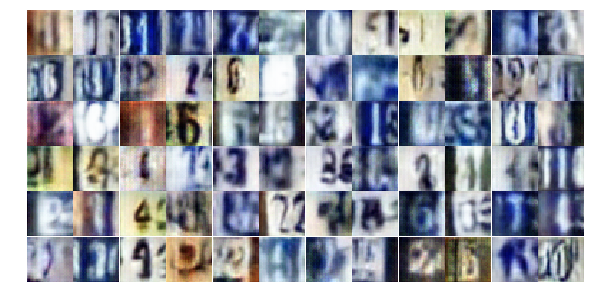

Epoch 10/25... Discriminator Loss: 0.8363... Generator Loss: 0.8579
Epoch 10/25... Discriminator Loss: 0.9125... Generator Loss: 2.6187
Epoch 10/25... Discriminator Loss: 0.7980... Generator Loss: 0.8390
Epoch 10/25... Discriminator Loss: 0.5948... Generator Loss: 1.3424
Epoch 10/25... Discriminator Loss: 0.6055... Generator Loss: 2.1940
Epoch 10/25... Discriminator Loss: 0.5811... Generator Loss: 1.0397
Epoch 10/25... Discriminator Loss: 0.6542... Generator Loss: 1.0652
Epoch 10/25... Discriminator Loss: 0.5885... Generator Loss: 1.1665
Epoch 10/25... Discriminator Loss: 0.5971... Generator Loss: 1.6305
Epoch 10/25... Discriminator Loss: 0.4588... Generator Loss: 1.5854


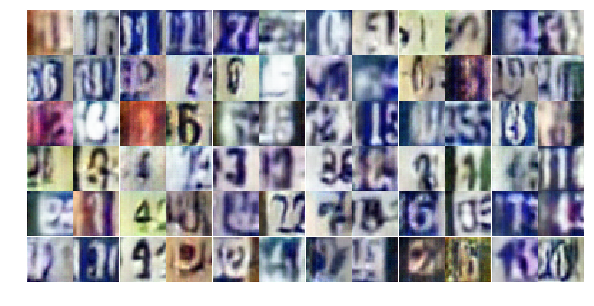

Epoch 10/25... Discriminator Loss: 0.6909... Generator Loss: 1.1262
Epoch 10/25... Discriminator Loss: 0.4358... Generator Loss: 1.4262
Epoch 10/25... Discriminator Loss: 0.9490... Generator Loss: 0.6745
Epoch 11/25... Discriminator Loss: 0.7024... Generator Loss: 1.1013
Epoch 11/25... Discriminator Loss: 0.4886... Generator Loss: 1.6508
Epoch 11/25... Discriminator Loss: 1.3144... Generator Loss: 0.4372
Epoch 11/25... Discriminator Loss: 0.8871... Generator Loss: 0.7364
Epoch 11/25... Discriminator Loss: 0.6989... Generator Loss: 1.0681
Epoch 11/25... Discriminator Loss: 1.7058... Generator Loss: 0.4084
Epoch 11/25... Discriminator Loss: 0.5514... Generator Loss: 1.6888


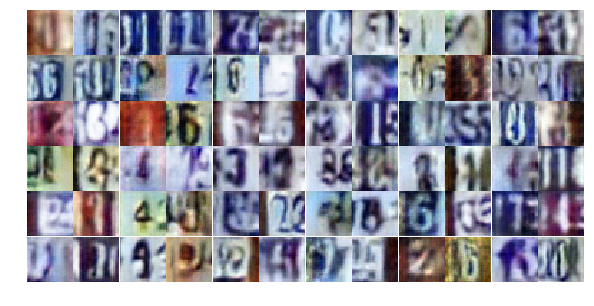

Epoch 11/25... Discriminator Loss: 0.3955... Generator Loss: 1.6896
Epoch 11/25... Discriminator Loss: 0.5785... Generator Loss: 1.1268
Epoch 11/25... Discriminator Loss: 0.3710... Generator Loss: 1.6962
Epoch 11/25... Discriminator Loss: 0.5453... Generator Loss: 2.1074
Epoch 11/25... Discriminator Loss: 0.9060... Generator Loss: 0.8954
Epoch 11/25... Discriminator Loss: 0.3877... Generator Loss: 1.6667
Epoch 11/25... Discriminator Loss: 0.6736... Generator Loss: 1.2268
Epoch 11/25... Discriminator Loss: 0.2732... Generator Loss: 2.1031
Epoch 11/25... Discriminator Loss: 0.4962... Generator Loss: 1.2419
Epoch 11/25... Discriminator Loss: 1.0467... Generator Loss: 1.6575


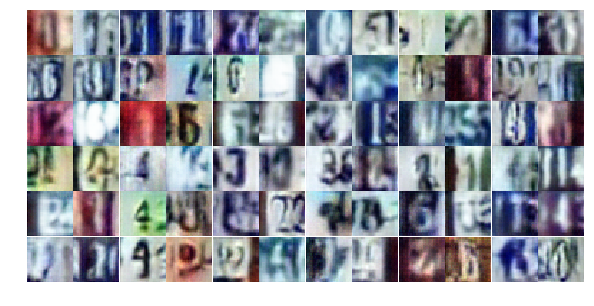

Epoch 11/25... Discriminator Loss: 1.4356... Generator Loss: 0.4180
Epoch 11/25... Discriminator Loss: 0.5654... Generator Loss: 1.6402
Epoch 11/25... Discriminator Loss: 0.9199... Generator Loss: 0.7060
Epoch 11/25... Discriminator Loss: 0.7678... Generator Loss: 0.8172
Epoch 11/25... Discriminator Loss: 0.3796... Generator Loss: 1.6567
Epoch 11/25... Discriminator Loss: 0.4036... Generator Loss: 1.5181
Epoch 11/25... Discriminator Loss: 0.5249... Generator Loss: 1.3180
Epoch 11/25... Discriminator Loss: 0.9474... Generator Loss: 0.7157
Epoch 11/25... Discriminator Loss: 0.4471... Generator Loss: 1.6378
Epoch 11/25... Discriminator Loss: 0.8939... Generator Loss: 0.7381


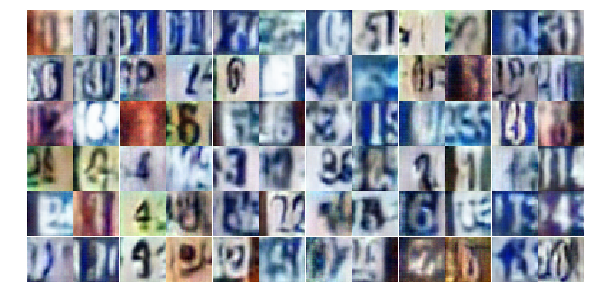

Epoch 11/25... Discriminator Loss: 0.7723... Generator Loss: 0.8575
Epoch 11/25... Discriminator Loss: 0.6033... Generator Loss: 1.7319
Epoch 11/25... Discriminator Loss: 0.7172... Generator Loss: 0.9718
Epoch 11/25... Discriminator Loss: 0.5015... Generator Loss: 1.2076
Epoch 11/25... Discriminator Loss: 0.6528... Generator Loss: 0.9358
Epoch 11/25... Discriminator Loss: 0.9969... Generator Loss: 0.6004
Epoch 11/25... Discriminator Loss: 0.7706... Generator Loss: 2.2730
Epoch 11/25... Discriminator Loss: 0.9497... Generator Loss: 0.6638
Epoch 11/25... Discriminator Loss: 0.4906... Generator Loss: 1.3994
Epoch 11/25... Discriminator Loss: 0.7837... Generator Loss: 0.8621


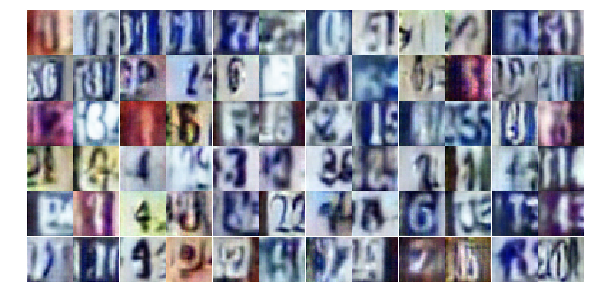

Epoch 11/25... Discriminator Loss: 0.4166... Generator Loss: 1.6431
Epoch 11/25... Discriminator Loss: 0.4227... Generator Loss: 1.5148
Epoch 11/25... Discriminator Loss: 0.5633... Generator Loss: 1.1333
Epoch 11/25... Discriminator Loss: 0.7050... Generator Loss: 1.0929
Epoch 11/25... Discriminator Loss: 0.8311... Generator Loss: 0.7689
Epoch 11/25... Discriminator Loss: 0.5618... Generator Loss: 1.1460
Epoch 11/25... Discriminator Loss: 0.4542... Generator Loss: 1.2764
Epoch 11/25... Discriminator Loss: 0.7239... Generator Loss: 0.8967
Epoch 11/25... Discriminator Loss: 1.3923... Generator Loss: 0.3936
Epoch 11/25... Discriminator Loss: 0.3523... Generator Loss: 1.7861


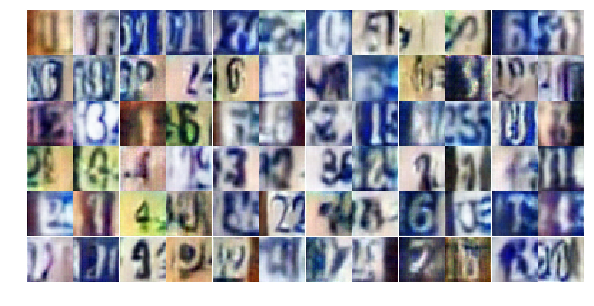

Epoch 11/25... Discriminator Loss: 0.7704... Generator Loss: 0.9559
Epoch 11/25... Discriminator Loss: 0.4125... Generator Loss: 1.5685
Epoch 11/25... Discriminator Loss: 0.5555... Generator Loss: 1.2451
Epoch 11/25... Discriminator Loss: 1.1558... Generator Loss: 3.9204
Epoch 11/25... Discriminator Loss: 1.3734... Generator Loss: 0.5398
Epoch 11/25... Discriminator Loss: 0.6320... Generator Loss: 2.3248
Epoch 11/25... Discriminator Loss: 0.6994... Generator Loss: 1.0210
Epoch 11/25... Discriminator Loss: 0.4827... Generator Loss: 1.8990
Epoch 11/25... Discriminator Loss: 1.0552... Generator Loss: 0.6117
Epoch 11/25... Discriminator Loss: 0.8118... Generator Loss: 0.8573


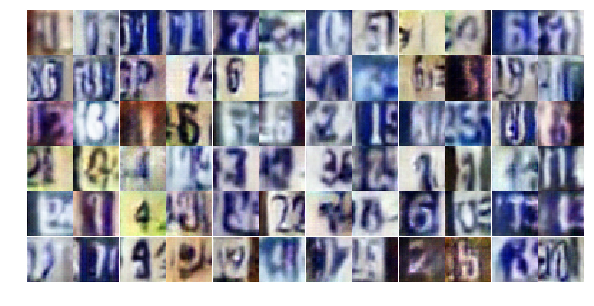

Epoch 12/25... Discriminator Loss: 0.6360... Generator Loss: 1.2556
Epoch 12/25... Discriminator Loss: 0.5801... Generator Loss: 1.4709
Epoch 12/25... Discriminator Loss: 0.6771... Generator Loss: 1.1775
Epoch 12/25... Discriminator Loss: 0.4197... Generator Loss: 1.8039
Epoch 12/25... Discriminator Loss: 0.5803... Generator Loss: 1.1243
Epoch 12/25... Discriminator Loss: 1.3675... Generator Loss: 0.4042
Epoch 12/25... Discriminator Loss: 0.9266... Generator Loss: 3.3752
Epoch 12/25... Discriminator Loss: 0.5334... Generator Loss: 1.6432
Epoch 12/25... Discriminator Loss: 0.6382... Generator Loss: 1.2388
Epoch 12/25... Discriminator Loss: 1.3027... Generator Loss: 0.4439


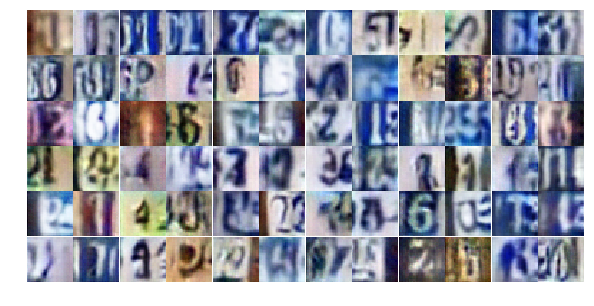

Epoch 12/25... Discriminator Loss: 0.4951... Generator Loss: 1.3125
Epoch 12/25... Discriminator Loss: 0.6805... Generator Loss: 1.0491
Epoch 12/25... Discriminator Loss: 0.4829... Generator Loss: 1.2996
Epoch 12/25... Discriminator Loss: 0.6893... Generator Loss: 1.0102
Epoch 12/25... Discriminator Loss: 0.3873... Generator Loss: 2.0827
Epoch 12/25... Discriminator Loss: 1.0064... Generator Loss: 0.7031
Epoch 12/25... Discriminator Loss: 1.8310... Generator Loss: 0.2741
Epoch 12/25... Discriminator Loss: 0.3829... Generator Loss: 2.0094
Epoch 12/25... Discriminator Loss: 0.4547... Generator Loss: 1.5011
Epoch 12/25... Discriminator Loss: 0.8520... Generator Loss: 0.7474


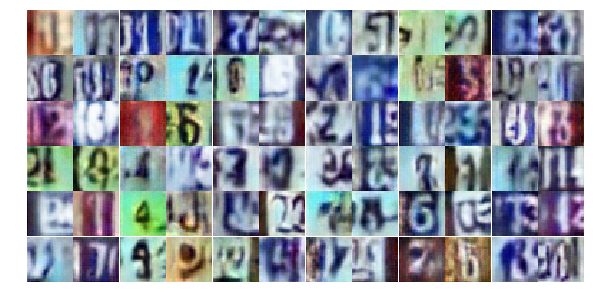

Epoch 12/25... Discriminator Loss: 0.3379... Generator Loss: 1.7889
Epoch 12/25... Discriminator Loss: 0.3942... Generator Loss: 1.5166
Epoch 12/25... Discriminator Loss: 0.5730... Generator Loss: 1.3996
Epoch 12/25... Discriminator Loss: 0.4347... Generator Loss: 1.7315
Epoch 12/25... Discriminator Loss: 0.3443... Generator Loss: 1.8129
Epoch 12/25... Discriminator Loss: 0.3864... Generator Loss: 1.6186
Epoch 12/25... Discriminator Loss: 0.5272... Generator Loss: 1.6017
Epoch 12/25... Discriminator Loss: 0.3259... Generator Loss: 2.1119
Epoch 12/25... Discriminator Loss: 0.7179... Generator Loss: 1.8227
Epoch 12/25... Discriminator Loss: 0.7807... Generator Loss: 0.8617


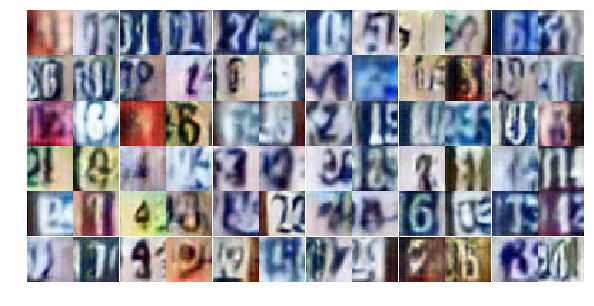

Epoch 12/25... Discriminator Loss: 0.5746... Generator Loss: 1.1919
Epoch 12/25... Discriminator Loss: 0.6467... Generator Loss: 1.2497
Epoch 12/25... Discriminator Loss: 0.8716... Generator Loss: 0.7488
Epoch 12/25... Discriminator Loss: 1.8797... Generator Loss: 0.2378
Epoch 12/25... Discriminator Loss: 1.3299... Generator Loss: 0.5200
Epoch 12/25... Discriminator Loss: 0.8599... Generator Loss: 1.1222
Epoch 12/25... Discriminator Loss: 0.6309... Generator Loss: 1.2115
Epoch 12/25... Discriminator Loss: 1.1631... Generator Loss: 0.5563
Epoch 12/25... Discriminator Loss: 0.5105... Generator Loss: 1.5273
Epoch 12/25... Discriminator Loss: 0.2934... Generator Loss: 1.8377


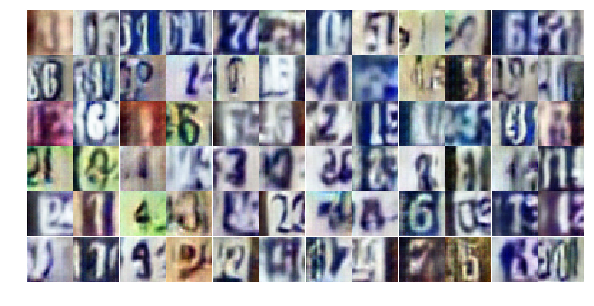

Epoch 12/25... Discriminator Loss: 0.6604... Generator Loss: 0.9898
Epoch 12/25... Discriminator Loss: 0.3678... Generator Loss: 1.6802
Epoch 12/25... Discriminator Loss: 0.5503... Generator Loss: 1.1419
Epoch 12/25... Discriminator Loss: 0.6092... Generator Loss: 1.0772
Epoch 12/25... Discriminator Loss: 0.5353... Generator Loss: 1.1396
Epoch 12/25... Discriminator Loss: 1.1867... Generator Loss: 0.5424
Epoch 12/25... Discriminator Loss: 1.1798... Generator Loss: 0.6250
Epoch 12/25... Discriminator Loss: 1.0771... Generator Loss: 0.6185
Epoch 12/25... Discriminator Loss: 0.5631... Generator Loss: 1.1965
Epoch 12/25... Discriminator Loss: 0.8096... Generator Loss: 0.8292


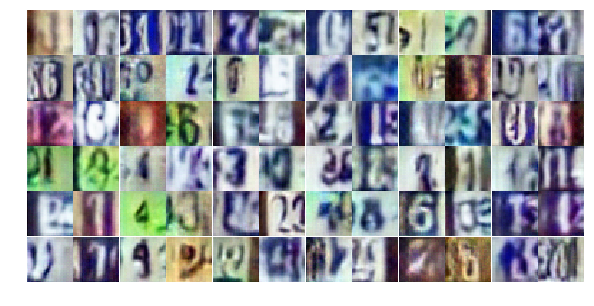

Epoch 12/25... Discriminator Loss: 0.8015... Generator Loss: 0.8711
Epoch 12/25... Discriminator Loss: 0.6625... Generator Loss: 0.9890
Epoch 12/25... Discriminator Loss: 0.5840... Generator Loss: 1.9212
Epoch 12/25... Discriminator Loss: 1.1774... Generator Loss: 0.8162
Epoch 12/25... Discriminator Loss: 0.5277... Generator Loss: 1.2554
Epoch 12/25... Discriminator Loss: 0.6902... Generator Loss: 1.1195
Epoch 12/25... Discriminator Loss: 0.6905... Generator Loss: 0.9534
Epoch 13/25... Discriminator Loss: 0.5708... Generator Loss: 1.1160
Epoch 13/25... Discriminator Loss: 0.3825... Generator Loss: 1.8811
Epoch 13/25... Discriminator Loss: 0.8649... Generator Loss: 0.7425


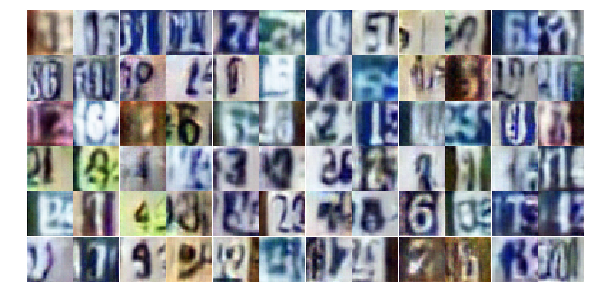

Epoch 13/25... Discriminator Loss: 0.4928... Generator Loss: 1.4150
Epoch 13/25... Discriminator Loss: 0.4938... Generator Loss: 1.4542
Epoch 13/25... Discriminator Loss: 1.2616... Generator Loss: 0.4745
Epoch 13/25... Discriminator Loss: 0.9114... Generator Loss: 0.9912
Epoch 13/25... Discriminator Loss: 0.6607... Generator Loss: 1.0170
Epoch 13/25... Discriminator Loss: 0.4763... Generator Loss: 1.4418
Epoch 13/25... Discriminator Loss: 0.3515... Generator Loss: 1.8027
Epoch 13/25... Discriminator Loss: 0.5661... Generator Loss: 1.1430
Epoch 13/25... Discriminator Loss: 0.5408... Generator Loss: 1.1113
Epoch 13/25... Discriminator Loss: 0.4495... Generator Loss: 1.7490


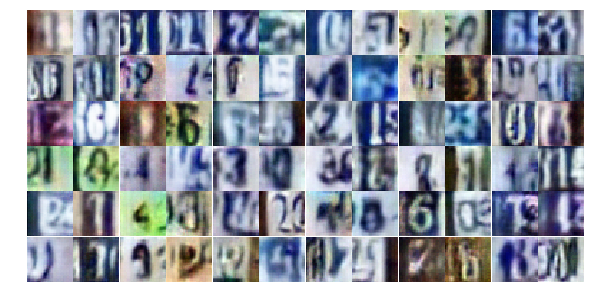

Epoch 13/25... Discriminator Loss: 2.3056... Generator Loss: 5.4873
Epoch 13/25... Discriminator Loss: 0.7363... Generator Loss: 1.0619
Epoch 13/25... Discriminator Loss: 0.8886... Generator Loss: 0.7402
Epoch 13/25... Discriminator Loss: 0.5948... Generator Loss: 1.1610
Epoch 13/25... Discriminator Loss: 0.6055... Generator Loss: 1.0825
Epoch 13/25... Discriminator Loss: 0.7219... Generator Loss: 1.5798
Epoch 13/25... Discriminator Loss: 0.6516... Generator Loss: 1.0382
Epoch 13/25... Discriminator Loss: 0.8336... Generator Loss: 0.7904
Epoch 13/25... Discriminator Loss: 0.6009... Generator Loss: 1.0605
Epoch 13/25... Discriminator Loss: 0.9824... Generator Loss: 0.6699


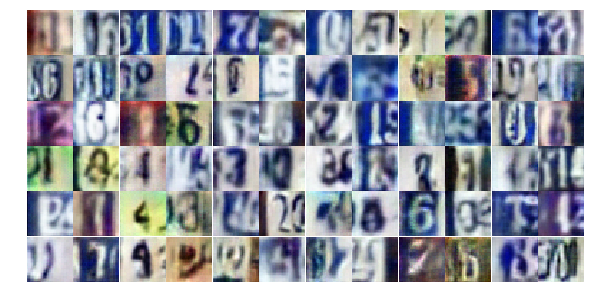

Epoch 13/25... Discriminator Loss: 0.5820... Generator Loss: 1.1123
Epoch 13/25... Discriminator Loss: 0.6877... Generator Loss: 1.0316
Epoch 13/25... Discriminator Loss: 0.5479... Generator Loss: 1.2835
Epoch 13/25... Discriminator Loss: 0.5524... Generator Loss: 1.1559
Epoch 13/25... Discriminator Loss: 0.5940... Generator Loss: 1.1634
Epoch 13/25... Discriminator Loss: 2.1379... Generator Loss: 0.1990
Epoch 13/25... Discriminator Loss: 0.7675... Generator Loss: 1.5550
Epoch 13/25... Discriminator Loss: 0.5063... Generator Loss: 1.4802
Epoch 13/25... Discriminator Loss: 0.4985... Generator Loss: 1.3794
Epoch 13/25... Discriminator Loss: 0.5536... Generator Loss: 1.4220


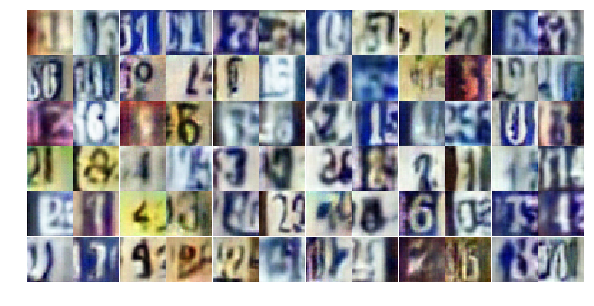

Epoch 13/25... Discriminator Loss: 1.4293... Generator Loss: 0.3881
Epoch 13/25... Discriminator Loss: 1.2801... Generator Loss: 3.2177
Epoch 13/25... Discriminator Loss: 1.0327... Generator Loss: 0.6600
Epoch 13/25... Discriminator Loss: 1.0984... Generator Loss: 0.6001
Epoch 13/25... Discriminator Loss: 0.4587... Generator Loss: 1.4634
Epoch 13/25... Discriminator Loss: 0.5807... Generator Loss: 1.1116
Epoch 13/25... Discriminator Loss: 0.4717... Generator Loss: 1.3352
Epoch 13/25... Discriminator Loss: 0.6399... Generator Loss: 1.2303
Epoch 13/25... Discriminator Loss: 0.4499... Generator Loss: 1.5219
Epoch 13/25... Discriminator Loss: 0.6367... Generator Loss: 1.0346


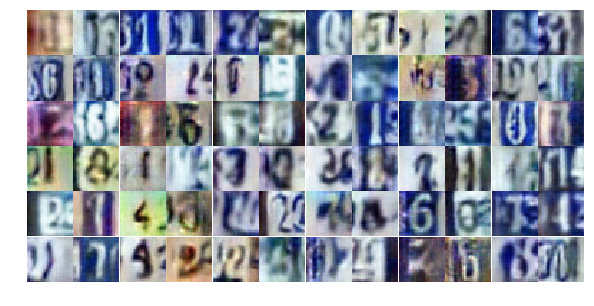

Epoch 13/25... Discriminator Loss: 0.5004... Generator Loss: 1.7312
Epoch 13/25... Discriminator Loss: 0.7461... Generator Loss: 1.2848
Epoch 13/25... Discriminator Loss: 1.4442... Generator Loss: 0.4310
Epoch 13/25... Discriminator Loss: 0.6319... Generator Loss: 1.1044
Epoch 13/25... Discriminator Loss: 1.1866... Generator Loss: 0.5112
Epoch 13/25... Discriminator Loss: 0.6905... Generator Loss: 1.3220
Epoch 13/25... Discriminator Loss: 0.5484... Generator Loss: 1.2997
Epoch 13/25... Discriminator Loss: 0.5573... Generator Loss: 1.1641
Epoch 13/25... Discriminator Loss: 0.9780... Generator Loss: 0.6500
Epoch 13/25... Discriminator Loss: 0.9052... Generator Loss: 0.7858


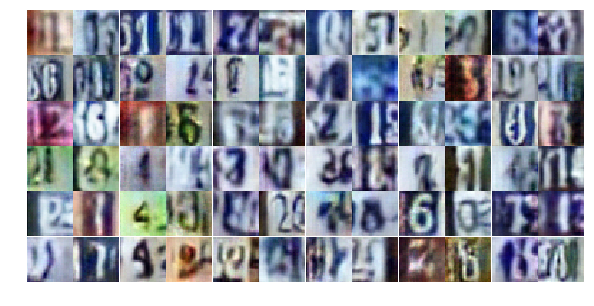

Epoch 13/25... Discriminator Loss: 0.3136... Generator Loss: 2.2897
Epoch 13/25... Discriminator Loss: 1.2123... Generator Loss: 0.4500
Epoch 13/25... Discriminator Loss: 0.5060... Generator Loss: 1.7682
Epoch 13/25... Discriminator Loss: 1.4188... Generator Loss: 0.4343
Epoch 14/25... Discriminator Loss: 0.8512... Generator Loss: 0.9309
Epoch 14/25... Discriminator Loss: 0.6761... Generator Loss: 1.0696
Epoch 14/25... Discriminator Loss: 0.8471... Generator Loss: 0.8480
Epoch 14/25... Discriminator Loss: 0.6782... Generator Loss: 1.9770
Epoch 14/25... Discriminator Loss: 0.5484... Generator Loss: 1.2565
Epoch 14/25... Discriminator Loss: 0.8367... Generator Loss: 1.0775


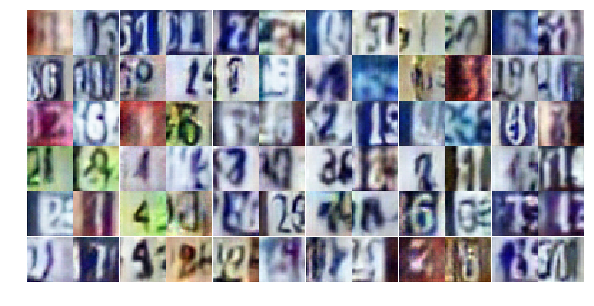

Epoch 14/25... Discriminator Loss: 0.8216... Generator Loss: 2.1850
Epoch 14/25... Discriminator Loss: 0.6633... Generator Loss: 0.9351
Epoch 14/25... Discriminator Loss: 0.4472... Generator Loss: 1.6919
Epoch 14/25... Discriminator Loss: 0.5765... Generator Loss: 1.2203
Epoch 14/25... Discriminator Loss: 1.4005... Generator Loss: 0.4037
Epoch 14/25... Discriminator Loss: 0.4894... Generator Loss: 1.1899
Epoch 14/25... Discriminator Loss: 0.3390... Generator Loss: 1.8309
Epoch 14/25... Discriminator Loss: 1.2020... Generator Loss: 0.4699
Epoch 14/25... Discriminator Loss: 1.0355... Generator Loss: 0.6636
Epoch 14/25... Discriminator Loss: 0.7923... Generator Loss: 0.8560


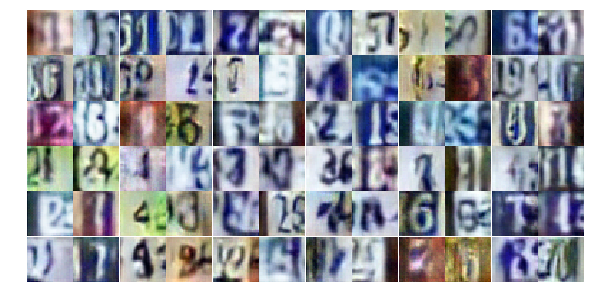

Epoch 14/25... Discriminator Loss: 0.4242... Generator Loss: 1.3469
Epoch 14/25... Discriminator Loss: 0.3945... Generator Loss: 1.8660
Epoch 14/25... Discriminator Loss: 0.7665... Generator Loss: 0.9510
Epoch 14/25... Discriminator Loss: 0.3700... Generator Loss: 2.0038
Epoch 14/25... Discriminator Loss: 0.9680... Generator Loss: 0.6525
Epoch 14/25... Discriminator Loss: 0.5859... Generator Loss: 1.0838
Epoch 14/25... Discriminator Loss: 0.6906... Generator Loss: 0.9603
Epoch 14/25... Discriminator Loss: 1.0154... Generator Loss: 0.6110
Epoch 14/25... Discriminator Loss: 0.7689... Generator Loss: 0.8630
Epoch 14/25... Discriminator Loss: 0.4802... Generator Loss: 2.2101


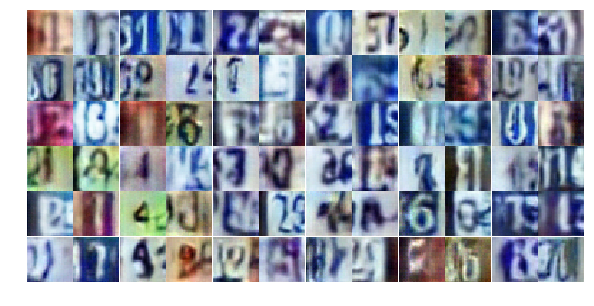

Epoch 14/25... Discriminator Loss: 1.6709... Generator Loss: 0.3248
Epoch 14/25... Discriminator Loss: 0.5155... Generator Loss: 2.8198
Epoch 14/25... Discriminator Loss: 0.2241... Generator Loss: 2.5493
Epoch 14/25... Discriminator Loss: 0.3798... Generator Loss: 1.9647
Epoch 14/25... Discriminator Loss: 0.7517... Generator Loss: 1.0531
Epoch 14/25... Discriminator Loss: 0.8766... Generator Loss: 0.7588
Epoch 14/25... Discriminator Loss: 0.9928... Generator Loss: 0.6344
Epoch 14/25... Discriminator Loss: 0.3450... Generator Loss: 1.6595
Epoch 14/25... Discriminator Loss: 0.3698... Generator Loss: 1.5470
Epoch 14/25... Discriminator Loss: 0.7876... Generator Loss: 1.4296


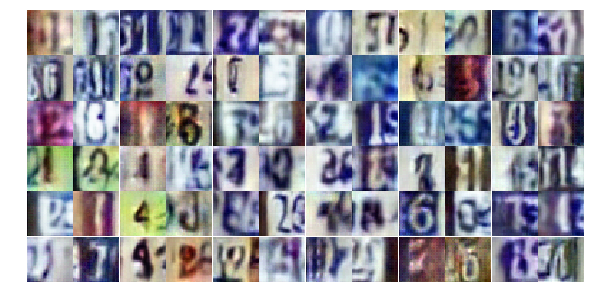

Epoch 14/25... Discriminator Loss: 0.9307... Generator Loss: 0.6931
Epoch 14/25... Discriminator Loss: 0.7969... Generator Loss: 0.9152
Epoch 14/25... Discriminator Loss: 0.6358... Generator Loss: 1.0120
Epoch 14/25... Discriminator Loss: 0.9298... Generator Loss: 0.7146
Epoch 14/25... Discriminator Loss: 0.6238... Generator Loss: 1.2275
Epoch 14/25... Discriminator Loss: 0.7619... Generator Loss: 0.8494
Epoch 14/25... Discriminator Loss: 0.7372... Generator Loss: 0.9331
Epoch 14/25... Discriminator Loss: 0.5521... Generator Loss: 1.2509
Epoch 14/25... Discriminator Loss: 1.1605... Generator Loss: 0.5658
Epoch 14/25... Discriminator Loss: 1.3345... Generator Loss: 0.4122


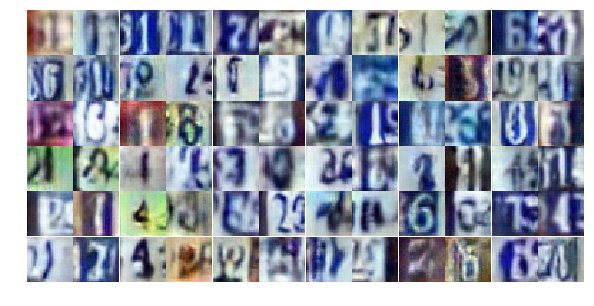

Epoch 14/25... Discriminator Loss: 0.6806... Generator Loss: 1.6625
Epoch 14/25... Discriminator Loss: 0.9125... Generator Loss: 0.7577
Epoch 14/25... Discriminator Loss: 0.4793... Generator Loss: 1.4718
Epoch 14/25... Discriminator Loss: 0.7300... Generator Loss: 0.9539
Epoch 14/25... Discriminator Loss: 0.5540... Generator Loss: 1.3758
Epoch 14/25... Discriminator Loss: 0.5239... Generator Loss: 1.1638
Epoch 14/25... Discriminator Loss: 0.5352... Generator Loss: 1.5633
Epoch 14/25... Discriminator Loss: 0.8152... Generator Loss: 0.7983
Epoch 14/25... Discriminator Loss: 2.0591... Generator Loss: 3.5769
Epoch 14/25... Discriminator Loss: 1.1090... Generator Loss: 0.6268


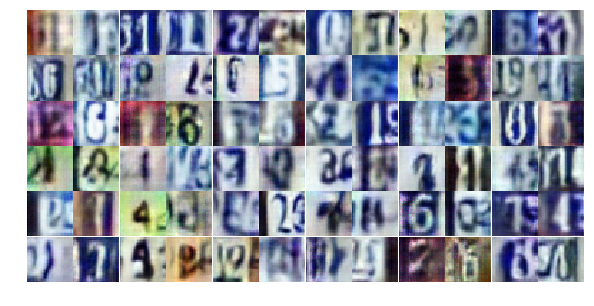

Epoch 14/25... Discriminator Loss: 0.9661... Generator Loss: 0.7236
Epoch 14/25... Discriminator Loss: 1.1988... Generator Loss: 0.4955
Epoch 15/25... Discriminator Loss: 0.5953... Generator Loss: 1.3592
Epoch 15/25... Discriminator Loss: 0.5742... Generator Loss: 1.3522
Epoch 15/25... Discriminator Loss: 0.5114... Generator Loss: 1.3165
Epoch 15/25... Discriminator Loss: 0.6397... Generator Loss: 1.0236
Epoch 15/25... Discriminator Loss: 0.5868... Generator Loss: 1.1800
Epoch 15/25... Discriminator Loss: 0.4975... Generator Loss: 1.5711
Epoch 15/25... Discriminator Loss: 0.9713... Generator Loss: 0.6888
Epoch 15/25... Discriminator Loss: 0.4542... Generator Loss: 1.4230


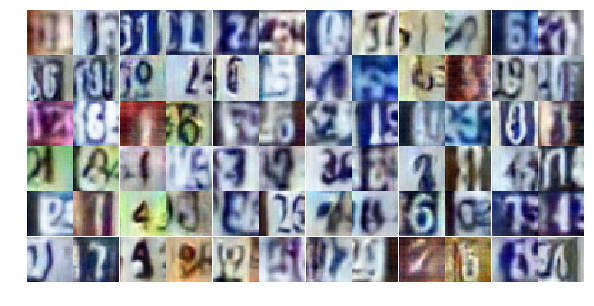

Epoch 15/25... Discriminator Loss: 0.6276... Generator Loss: 1.2904
Epoch 15/25... Discriminator Loss: 0.7664... Generator Loss: 1.4121
Epoch 15/25... Discriminator Loss: 0.8403... Generator Loss: 0.7992
Epoch 15/25... Discriminator Loss: 0.6218... Generator Loss: 1.0676
Epoch 15/25... Discriminator Loss: 0.8120... Generator Loss: 1.0951
Epoch 15/25... Discriminator Loss: 0.4649... Generator Loss: 1.7903
Epoch 15/25... Discriminator Loss: 0.6280... Generator Loss: 1.3061
Epoch 15/25... Discriminator Loss: 0.7032... Generator Loss: 1.1331
Epoch 15/25... Discriminator Loss: 0.7604... Generator Loss: 3.1158
Epoch 15/25... Discriminator Loss: 1.3847... Generator Loss: 0.3682


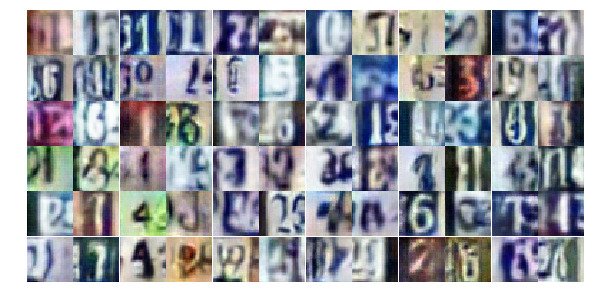

Epoch 15/25... Discriminator Loss: 0.7843... Generator Loss: 1.1059
Epoch 15/25... Discriminator Loss: 0.6247... Generator Loss: 1.0968
Epoch 15/25... Discriminator Loss: 0.5221... Generator Loss: 1.3511
Epoch 15/25... Discriminator Loss: 0.9063... Generator Loss: 0.7215
Epoch 15/25... Discriminator Loss: 0.7630... Generator Loss: 0.9723
Epoch 15/25... Discriminator Loss: 0.6391... Generator Loss: 1.1495
Epoch 15/25... Discriminator Loss: 1.4413... Generator Loss: 0.4199
Epoch 15/25... Discriminator Loss: 0.7128... Generator Loss: 0.9622
Epoch 15/25... Discriminator Loss: 0.8678... Generator Loss: 0.7473
Epoch 15/25... Discriminator Loss: 1.5204... Generator Loss: 0.4044


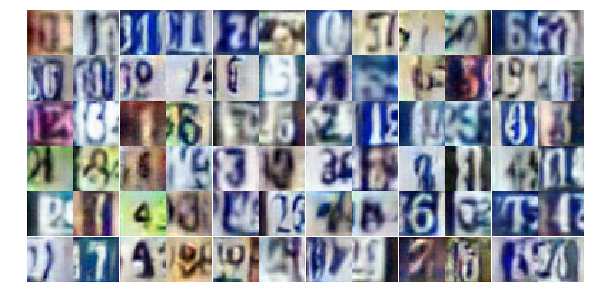

Epoch 15/25... Discriminator Loss: 0.8242... Generator Loss: 0.8144
Epoch 15/25... Discriminator Loss: 0.8154... Generator Loss: 1.0656
Epoch 15/25... Discriminator Loss: 0.4510... Generator Loss: 1.3727
Epoch 15/25... Discriminator Loss: 0.5555... Generator Loss: 1.1981
Epoch 15/25... Discriminator Loss: 0.5349... Generator Loss: 1.3846
Epoch 15/25... Discriminator Loss: 1.0577... Generator Loss: 2.3866
Epoch 15/25... Discriminator Loss: 1.3488... Generator Loss: 1.1124
Epoch 15/25... Discriminator Loss: 0.7878... Generator Loss: 0.9264
Epoch 15/25... Discriminator Loss: 0.4365... Generator Loss: 1.6818
Epoch 15/25... Discriminator Loss: 0.5023... Generator Loss: 1.3090


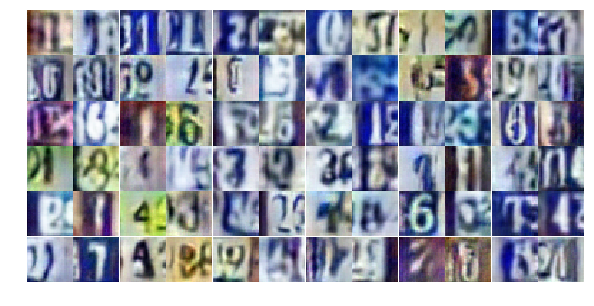

Epoch 15/25... Discriminator Loss: 0.6144... Generator Loss: 1.1185
Epoch 15/25... Discriminator Loss: 0.9594... Generator Loss: 0.7067
Epoch 15/25... Discriminator Loss: 0.7150... Generator Loss: 0.9571
Epoch 15/25... Discriminator Loss: 0.4638... Generator Loss: 1.3485
Epoch 15/25... Discriminator Loss: 0.5131... Generator Loss: 1.2354
Epoch 15/25... Discriminator Loss: 1.5279... Generator Loss: 0.4309
Epoch 15/25... Discriminator Loss: 0.4140... Generator Loss: 1.6280
Epoch 15/25... Discriminator Loss: 0.8036... Generator Loss: 1.1582
Epoch 15/25... Discriminator Loss: 0.7280... Generator Loss: 1.0299
Epoch 15/25... Discriminator Loss: 0.6752... Generator Loss: 0.9926


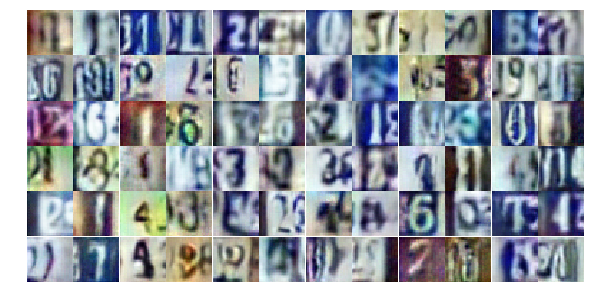

Epoch 15/25... Discriminator Loss: 0.9076... Generator Loss: 0.6909
Epoch 15/25... Discriminator Loss: 0.7857... Generator Loss: 0.7971
Epoch 15/25... Discriminator Loss: 0.5150... Generator Loss: 1.2709
Epoch 15/25... Discriminator Loss: 1.6189... Generator Loss: 0.3225
Epoch 15/25... Discriminator Loss: 0.4743... Generator Loss: 1.4418
Epoch 15/25... Discriminator Loss: 4.7761... Generator Loss: 6.8544
Epoch 15/25... Discriminator Loss: 1.0706... Generator Loss: 0.7690
Epoch 15/25... Discriminator Loss: 0.7403... Generator Loss: 1.0617
Epoch 15/25... Discriminator Loss: 1.4214... Generator Loss: 0.3987
Epoch 16/25... Discriminator Loss: 1.1537... Generator Loss: 0.5311


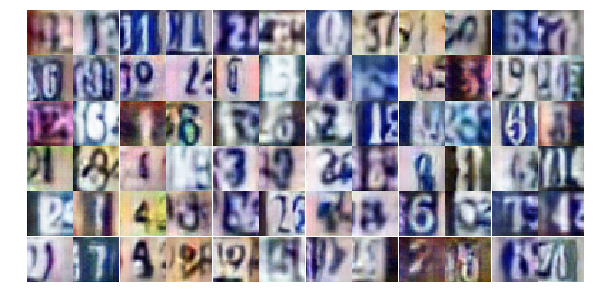

Epoch 16/25... Discriminator Loss: 0.5142... Generator Loss: 1.3460
Epoch 16/25... Discriminator Loss: 0.6610... Generator Loss: 1.0378
Epoch 16/25... Discriminator Loss: 0.7424... Generator Loss: 1.0326
Epoch 16/25... Discriminator Loss: 0.6743... Generator Loss: 1.1659
Epoch 16/25... Discriminator Loss: 0.6196... Generator Loss: 1.4156
Epoch 16/25... Discriminator Loss: 0.6977... Generator Loss: 0.9799
Epoch 16/25... Discriminator Loss: 1.3853... Generator Loss: 0.3940
Epoch 16/25... Discriminator Loss: 0.8028... Generator Loss: 0.8448
Epoch 16/25... Discriminator Loss: 0.4152... Generator Loss: 1.4719
Epoch 16/25... Discriminator Loss: 0.5703... Generator Loss: 1.0975


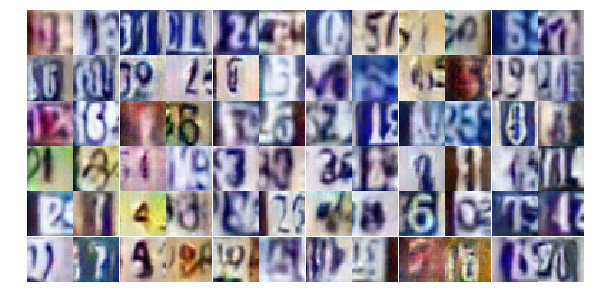

Epoch 16/25... Discriminator Loss: 0.9277... Generator Loss: 0.7319
Epoch 16/25... Discriminator Loss: 0.5218... Generator Loss: 1.4040
Epoch 16/25... Discriminator Loss: 0.5162... Generator Loss: 1.4470
Epoch 16/25... Discriminator Loss: 1.1710... Generator Loss: 0.5418
Epoch 16/25... Discriminator Loss: 0.5013... Generator Loss: 1.3046
Epoch 16/25... Discriminator Loss: 0.6878... Generator Loss: 1.1038
Epoch 16/25... Discriminator Loss: 1.9862... Generator Loss: 0.2045
Epoch 16/25... Discriminator Loss: 0.5316... Generator Loss: 1.5524
Epoch 16/25... Discriminator Loss: 0.4783... Generator Loss: 1.2720
Epoch 16/25... Discriminator Loss: 0.6164... Generator Loss: 1.1176


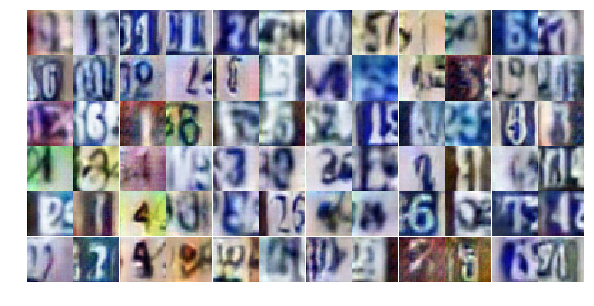

Epoch 16/25... Discriminator Loss: 0.5431... Generator Loss: 1.2897
Epoch 16/25... Discriminator Loss: 0.5726... Generator Loss: 1.4141
Epoch 16/25... Discriminator Loss: 0.6992... Generator Loss: 1.1479
Epoch 16/25... Discriminator Loss: 0.9665... Generator Loss: 0.6546
Epoch 16/25... Discriminator Loss: 0.6132... Generator Loss: 1.4466
Epoch 16/25... Discriminator Loss: 0.7995... Generator Loss: 0.8897
Epoch 16/25... Discriminator Loss: 0.7787... Generator Loss: 0.8195
Epoch 16/25... Discriminator Loss: 0.5557... Generator Loss: 1.2505
Epoch 16/25... Discriminator Loss: 0.7353... Generator Loss: 0.9901
Epoch 16/25... Discriminator Loss: 0.5273... Generator Loss: 1.1917


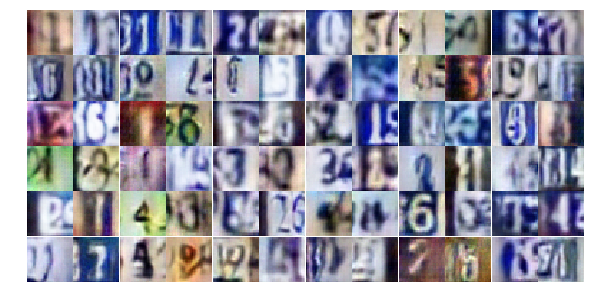

Epoch 16/25... Discriminator Loss: 0.4371... Generator Loss: 1.4109
Epoch 16/25... Discriminator Loss: 0.4495... Generator Loss: 1.5124
Epoch 16/25... Discriminator Loss: 0.5438... Generator Loss: 1.2301
Epoch 16/25... Discriminator Loss: 2.4547... Generator Loss: 4.3006
Epoch 16/25... Discriminator Loss: 1.3032... Generator Loss: 0.4685
Epoch 16/25... Discriminator Loss: 0.6064... Generator Loss: 1.2607
Epoch 16/25... Discriminator Loss: 0.8992... Generator Loss: 0.7517
Epoch 16/25... Discriminator Loss: 1.1170... Generator Loss: 0.5496
Epoch 16/25... Discriminator Loss: 0.9919... Generator Loss: 0.6679
Epoch 16/25... Discriminator Loss: 0.4828... Generator Loss: 1.4776


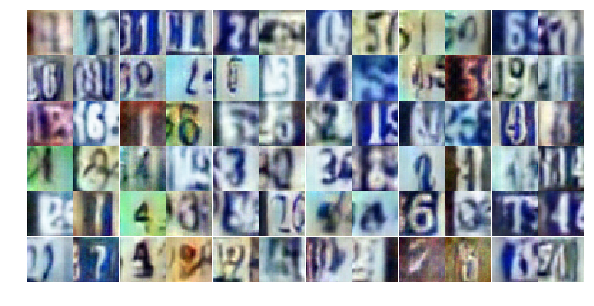

Epoch 16/25... Discriminator Loss: 0.4637... Generator Loss: 1.4476
Epoch 16/25... Discriminator Loss: 0.6165... Generator Loss: 1.8144
Epoch 16/25... Discriminator Loss: 1.0309... Generator Loss: 0.6695
Epoch 16/25... Discriminator Loss: 0.8273... Generator Loss: 1.7457
Epoch 16/25... Discriminator Loss: 0.6824... Generator Loss: 0.9495
Epoch 16/25... Discriminator Loss: 1.2336... Generator Loss: 0.4685
Epoch 16/25... Discriminator Loss: 0.4898... Generator Loss: 1.2870
Epoch 16/25... Discriminator Loss: 0.8803... Generator Loss: 0.7185
Epoch 16/25... Discriminator Loss: 0.5500... Generator Loss: 1.1395
Epoch 16/25... Discriminator Loss: 0.6678... Generator Loss: 1.0021


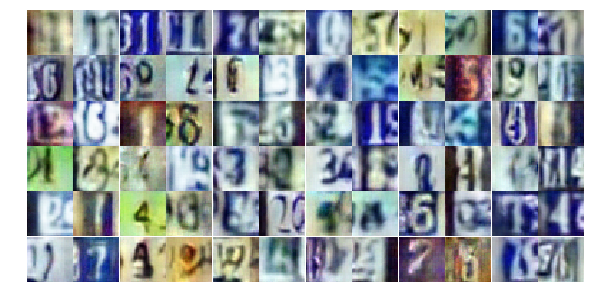

Epoch 16/25... Discriminator Loss: 1.3583... Generator Loss: 0.4543
Epoch 16/25... Discriminator Loss: 0.6404... Generator Loss: 1.6493
Epoch 16/25... Discriminator Loss: 1.5726... Generator Loss: 0.3664
Epoch 16/25... Discriminator Loss: 0.4979... Generator Loss: 1.5687
Epoch 16/25... Discriminator Loss: 0.3803... Generator Loss: 1.6667
Epoch 16/25... Discriminator Loss: 1.8376... Generator Loss: 0.2808
Epoch 17/25... Discriminator Loss: 0.7595... Generator Loss: 0.9602
Epoch 17/25... Discriminator Loss: 0.8241... Generator Loss: 0.8996
Epoch 17/25... Discriminator Loss: 0.6007... Generator Loss: 1.2405
Epoch 17/25... Discriminator Loss: 0.6800... Generator Loss: 1.0318


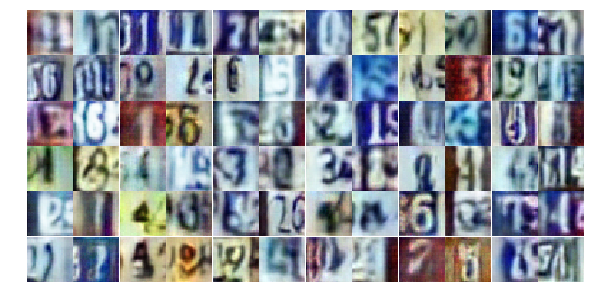

Epoch 17/25... Discriminator Loss: 0.5166... Generator Loss: 1.3946
Epoch 17/25... Discriminator Loss: 0.6046... Generator Loss: 1.0835
Epoch 17/25... Discriminator Loss: 0.8401... Generator Loss: 0.8650
Epoch 17/25... Discriminator Loss: 0.6515... Generator Loss: 0.9786
Epoch 17/25... Discriminator Loss: 1.0349... Generator Loss: 0.6820
Epoch 17/25... Discriminator Loss: 0.9232... Generator Loss: 0.7208
Epoch 17/25... Discriminator Loss: 0.5983... Generator Loss: 1.1109
Epoch 17/25... Discriminator Loss: 0.5142... Generator Loss: 1.2693
Epoch 17/25... Discriminator Loss: 0.2856... Generator Loss: 2.2868
Epoch 17/25... Discriminator Loss: 0.7034... Generator Loss: 2.3355


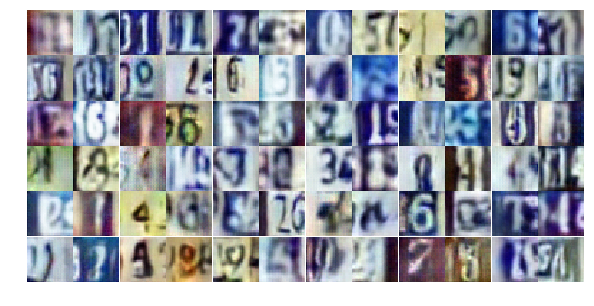

Epoch 17/25... Discriminator Loss: 0.7616... Generator Loss: 0.8966
Epoch 17/25... Discriminator Loss: 0.4882... Generator Loss: 2.3613
Epoch 17/25... Discriminator Loss: 0.7794... Generator Loss: 0.8909
Epoch 17/25... Discriminator Loss: 0.8914... Generator Loss: 0.7718
Epoch 17/25... Discriminator Loss: 0.5317... Generator Loss: 1.3122
Epoch 17/25... Discriminator Loss: 0.7500... Generator Loss: 0.8808
Epoch 17/25... Discriminator Loss: 0.6797... Generator Loss: 1.8164
Epoch 17/25... Discriminator Loss: 0.5902... Generator Loss: 1.1698
Epoch 17/25... Discriminator Loss: 0.6613... Generator Loss: 0.9998
Epoch 17/25... Discriminator Loss: 0.4957... Generator Loss: 1.4032


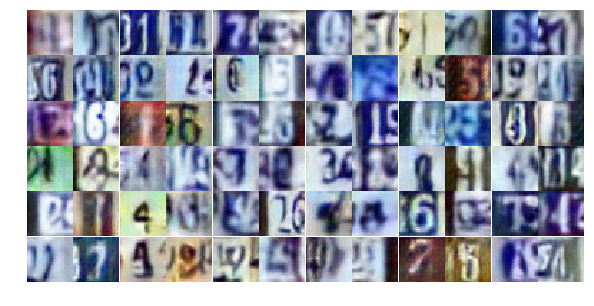

Epoch 17/25... Discriminator Loss: 1.5081... Generator Loss: 0.3938
Epoch 17/25... Discriminator Loss: 0.3579... Generator Loss: 1.8002
Epoch 17/25... Discriminator Loss: 0.3840... Generator Loss: 2.7363
Epoch 17/25... Discriminator Loss: 1.0567... Generator Loss: 0.6114
Epoch 17/25... Discriminator Loss: 1.3269... Generator Loss: 0.4503
Epoch 17/25... Discriminator Loss: 0.3830... Generator Loss: 1.7539
Epoch 17/25... Discriminator Loss: 1.1593... Generator Loss: 0.5764
Epoch 17/25... Discriminator Loss: 1.1243... Generator Loss: 0.5564
Epoch 17/25... Discriminator Loss: 1.4858... Generator Loss: 0.3493
Epoch 17/25... Discriminator Loss: 0.2658... Generator Loss: 2.2340


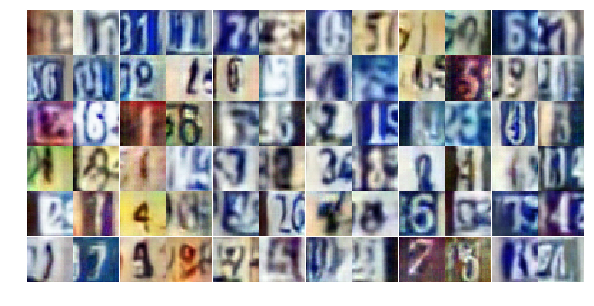

Epoch 17/25... Discriminator Loss: 1.0879... Generator Loss: 0.7053
Epoch 17/25... Discriminator Loss: 0.8688... Generator Loss: 1.5684
Epoch 17/25... Discriminator Loss: 0.5378... Generator Loss: 1.4086
Epoch 17/25... Discriminator Loss: 0.7126... Generator Loss: 1.5239
Epoch 17/25... Discriminator Loss: 0.5737... Generator Loss: 1.3184
Epoch 17/25... Discriminator Loss: 0.5527... Generator Loss: 1.6150
Epoch 17/25... Discriminator Loss: 0.5855... Generator Loss: 1.1803
Epoch 17/25... Discriminator Loss: 0.4848... Generator Loss: 1.6084
Epoch 17/25... Discriminator Loss: 0.2890... Generator Loss: 2.3295
Epoch 17/25... Discriminator Loss: 1.1329... Generator Loss: 0.5612


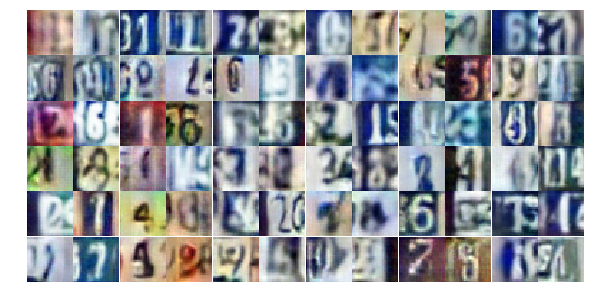

Epoch 17/25... Discriminator Loss: 1.1699... Generator Loss: 0.5621
Epoch 17/25... Discriminator Loss: 0.3825... Generator Loss: 1.9486
Epoch 17/25... Discriminator Loss: 0.5381... Generator Loss: 1.4757
Epoch 17/25... Discriminator Loss: 0.5468... Generator Loss: 1.1719
Epoch 17/25... Discriminator Loss: 0.6990... Generator Loss: 0.9866
Epoch 17/25... Discriminator Loss: 0.6945... Generator Loss: 0.9640
Epoch 17/25... Discriminator Loss: 0.6298... Generator Loss: 1.0270
Epoch 17/25... Discriminator Loss: 0.4951... Generator Loss: 1.4825
Epoch 17/25... Discriminator Loss: 1.0765... Generator Loss: 0.7414
Epoch 17/25... Discriminator Loss: 1.0424... Generator Loss: 0.7466


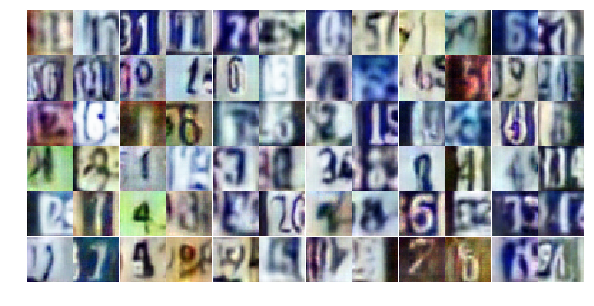

Epoch 17/25... Discriminator Loss: 0.7108... Generator Loss: 1.5361
Epoch 17/25... Discriminator Loss: 0.5528... Generator Loss: 1.9660
Epoch 17/25... Discriminator Loss: 0.7999... Generator Loss: 0.9042
Epoch 17/25... Discriminator Loss: 0.5207... Generator Loss: 2.8049
Epoch 18/25... Discriminator Loss: 0.8598... Generator Loss: 0.8091
Epoch 18/25... Discriminator Loss: 0.9425... Generator Loss: 0.6643
Epoch 18/25... Discriminator Loss: 0.7010... Generator Loss: 0.9844
Epoch 18/25... Discriminator Loss: 0.7019... Generator Loss: 0.9282
Epoch 18/25... Discriminator Loss: 1.3675... Generator Loss: 0.4446
Epoch 18/25... Discriminator Loss: 0.6454... Generator Loss: 1.1090


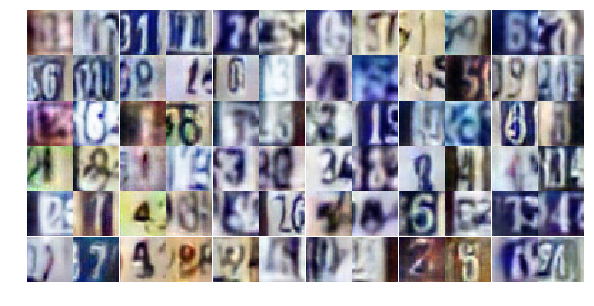

Epoch 18/25... Discriminator Loss: 2.0935... Generator Loss: 3.7203
Epoch 18/25... Discriminator Loss: 0.7361... Generator Loss: 1.8374
Epoch 18/25... Discriminator Loss: 0.7694... Generator Loss: 0.9553
Epoch 18/25... Discriminator Loss: 0.4971... Generator Loss: 2.0017
Epoch 18/25... Discriminator Loss: 0.7215... Generator Loss: 0.9854
Epoch 18/25... Discriminator Loss: 0.8371... Generator Loss: 0.8175
Epoch 18/25... Discriminator Loss: 0.5337... Generator Loss: 1.3501
Epoch 18/25... Discriminator Loss: 0.9459... Generator Loss: 0.7271
Epoch 18/25... Discriminator Loss: 0.5389... Generator Loss: 1.3094
Epoch 18/25... Discriminator Loss: 0.2961... Generator Loss: 1.7941


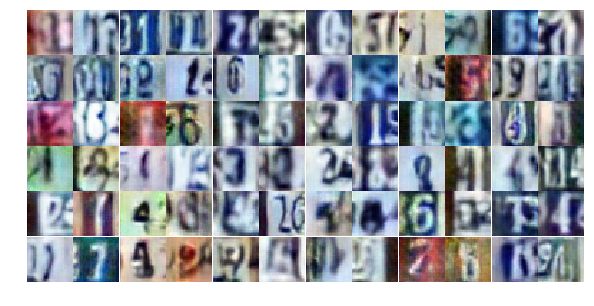

Epoch 18/25... Discriminator Loss: 0.5070... Generator Loss: 1.6837
Epoch 18/25... Discriminator Loss: 0.7412... Generator Loss: 1.0504
Epoch 18/25... Discriminator Loss: 1.0553... Generator Loss: 0.6803
Epoch 18/25... Discriminator Loss: 0.3915... Generator Loss: 1.6884
Epoch 18/25... Discriminator Loss: 0.5282... Generator Loss: 1.2704
Epoch 18/25... Discriminator Loss: 0.9443... Generator Loss: 0.7006
Epoch 18/25... Discriminator Loss: 0.8787... Generator Loss: 0.8125
Epoch 18/25... Discriminator Loss: 1.0345... Generator Loss: 0.6328
Epoch 18/25... Discriminator Loss: 1.0632... Generator Loss: 0.6068
Epoch 18/25... Discriminator Loss: 0.7399... Generator Loss: 0.8416


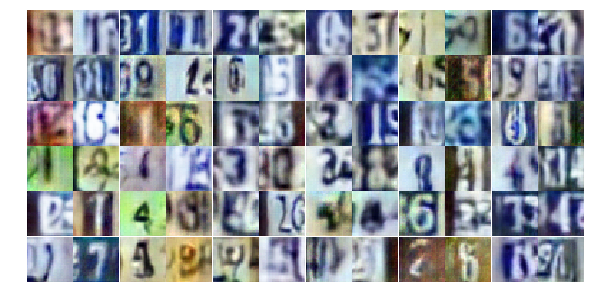

Epoch 18/25... Discriminator Loss: 0.5095... Generator Loss: 1.2166
Epoch 18/25... Discriminator Loss: 0.6460... Generator Loss: 1.1534
Epoch 18/25... Discriminator Loss: 0.6690... Generator Loss: 0.9967
Epoch 18/25... Discriminator Loss: 0.8006... Generator Loss: 0.8623
Epoch 18/25... Discriminator Loss: 1.1395... Generator Loss: 0.5171
Epoch 18/25... Discriminator Loss: 0.6074... Generator Loss: 1.1576
Epoch 18/25... Discriminator Loss: 0.9397... Generator Loss: 0.6667
Epoch 18/25... Discriminator Loss: 0.4276... Generator Loss: 1.4154
Epoch 18/25... Discriminator Loss: 0.5030... Generator Loss: 1.3082
Epoch 18/25... Discriminator Loss: 0.8145... Generator Loss: 0.9334


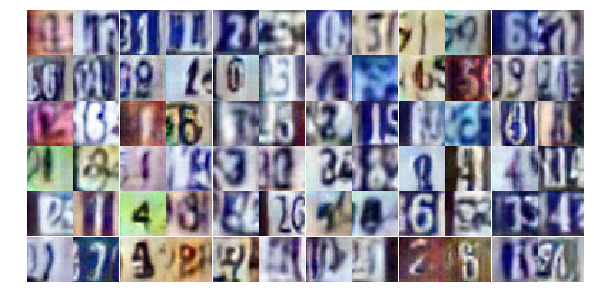

Epoch 18/25... Discriminator Loss: 0.6696... Generator Loss: 1.0282
Epoch 18/25... Discriminator Loss: 0.6530... Generator Loss: 0.9970
Epoch 18/25... Discriminator Loss: 0.8079... Generator Loss: 0.7835
Epoch 18/25... Discriminator Loss: 0.5248... Generator Loss: 1.3511
Epoch 18/25... Discriminator Loss: 0.5797... Generator Loss: 1.4455
Epoch 18/25... Discriminator Loss: 0.3620... Generator Loss: 1.6591
Epoch 18/25... Discriminator Loss: 0.7745... Generator Loss: 0.8980
Epoch 18/25... Discriminator Loss: 1.1635... Generator Loss: 3.0521
Epoch 18/25... Discriminator Loss: 0.5667... Generator Loss: 1.2531
Epoch 18/25... Discriminator Loss: 0.4772... Generator Loss: 1.5084


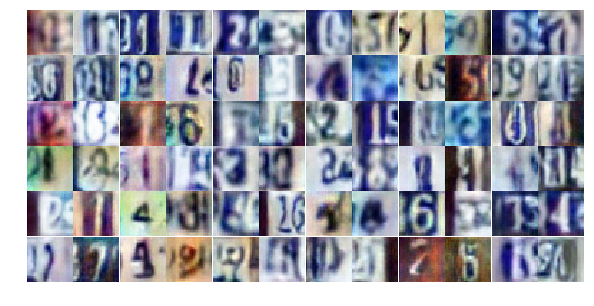

Epoch 18/25... Discriminator Loss: 0.7728... Generator Loss: 1.0208
Epoch 18/25... Discriminator Loss: 1.1025... Generator Loss: 0.6232
Epoch 18/25... Discriminator Loss: 0.6917... Generator Loss: 1.4056
Epoch 18/25... Discriminator Loss: 0.8252... Generator Loss: 0.8805
Epoch 18/25... Discriminator Loss: 0.5524... Generator Loss: 1.2101
Epoch 18/25... Discriminator Loss: 0.5942... Generator Loss: 2.0443
Epoch 18/25... Discriminator Loss: 0.6264... Generator Loss: 1.0449
Epoch 18/25... Discriminator Loss: 0.4710... Generator Loss: 1.3454
Epoch 18/25... Discriminator Loss: 0.7064... Generator Loss: 1.1386
Epoch 18/25... Discriminator Loss: 1.4040... Generator Loss: 0.4485


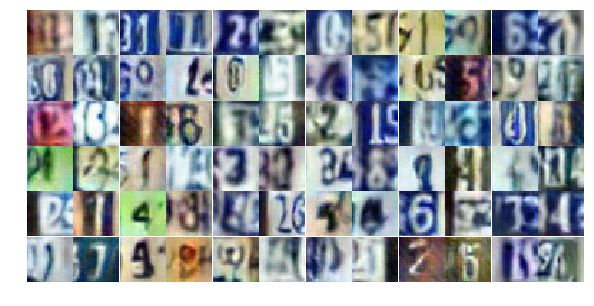

Epoch 18/25... Discriminator Loss: 0.5963... Generator Loss: 2.4467
Epoch 19/25... Discriminator Loss: 0.8466... Generator Loss: 1.6920
Epoch 19/25... Discriminator Loss: 1.5347... Generator Loss: 0.4197
Epoch 19/25... Discriminator Loss: 1.0547... Generator Loss: 0.6834
Epoch 19/25... Discriminator Loss: 0.5188... Generator Loss: 1.4001
Epoch 19/25... Discriminator Loss: 0.6617... Generator Loss: 1.0865
Epoch 19/25... Discriminator Loss: 0.4321... Generator Loss: 1.7479
Epoch 19/25... Discriminator Loss: 1.0014... Generator Loss: 0.6791
Epoch 19/25... Discriminator Loss: 0.5778... Generator Loss: 1.8459
Epoch 19/25... Discriminator Loss: 1.1954... Generator Loss: 0.5366


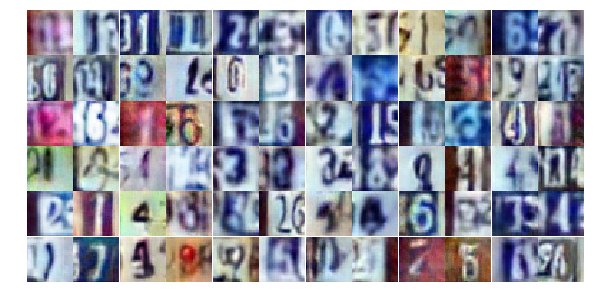

Epoch 19/25... Discriminator Loss: 0.5201... Generator Loss: 1.1676
Epoch 19/25... Discriminator Loss: 0.5326... Generator Loss: 1.3254
Epoch 19/25... Discriminator Loss: 0.6958... Generator Loss: 1.0623
Epoch 19/25... Discriminator Loss: 0.9804... Generator Loss: 0.6655
Epoch 19/25... Discriminator Loss: 0.7991... Generator Loss: 0.7848
Epoch 19/25... Discriminator Loss: 0.7384... Generator Loss: 0.9227
Epoch 19/25... Discriminator Loss: 0.9692... Generator Loss: 0.7102
Epoch 19/25... Discriminator Loss: 0.5164... Generator Loss: 1.2335
Epoch 19/25... Discriminator Loss: 0.6996... Generator Loss: 1.4112
Epoch 19/25... Discriminator Loss: 1.2500... Generator Loss: 0.5288


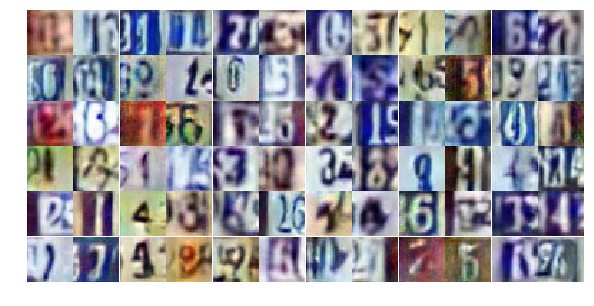

Epoch 19/25... Discriminator Loss: 0.5117... Generator Loss: 1.2261
Epoch 19/25... Discriminator Loss: 1.3739... Generator Loss: 0.4226
Epoch 19/25... Discriminator Loss: 1.3181... Generator Loss: 0.4397
Epoch 19/25... Discriminator Loss: 0.8562... Generator Loss: 0.8649
Epoch 19/25... Discriminator Loss: 1.1833... Generator Loss: 0.5103
Epoch 19/25... Discriminator Loss: 0.8297... Generator Loss: 0.8278
Epoch 19/25... Discriminator Loss: 0.4987... Generator Loss: 1.2871
Epoch 19/25... Discriminator Loss: 0.6230... Generator Loss: 1.0823
Epoch 19/25... Discriminator Loss: 0.7204... Generator Loss: 0.8591
Epoch 19/25... Discriminator Loss: 0.9361... Generator Loss: 0.7800


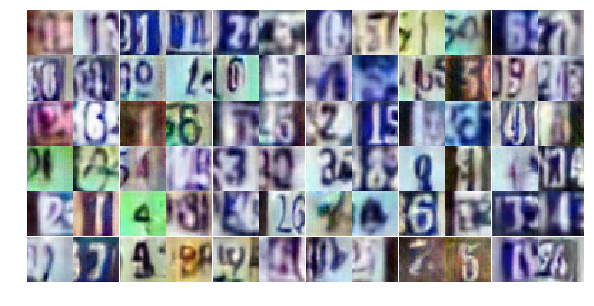

Epoch 19/25... Discriminator Loss: 0.7722... Generator Loss: 0.9222
Epoch 19/25... Discriminator Loss: 0.6679... Generator Loss: 0.9460
Epoch 19/25... Discriminator Loss: 1.0784... Generator Loss: 0.5476
Epoch 19/25... Discriminator Loss: 0.6219... Generator Loss: 1.0305
Epoch 19/25... Discriminator Loss: 0.6015... Generator Loss: 1.2890
Epoch 19/25... Discriminator Loss: 0.6997... Generator Loss: 1.1868
Epoch 19/25... Discriminator Loss: 0.5670... Generator Loss: 1.5204
Epoch 19/25... Discriminator Loss: 0.5615... Generator Loss: 1.3428
Epoch 19/25... Discriminator Loss: 0.6562... Generator Loss: 1.1622
Epoch 19/25... Discriminator Loss: 0.5668... Generator Loss: 1.1142


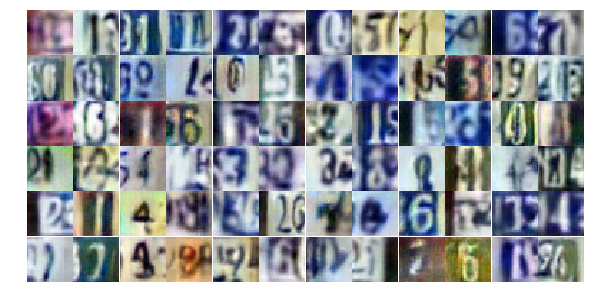

Epoch 19/25... Discriminator Loss: 0.5434... Generator Loss: 1.0947
Epoch 19/25... Discriminator Loss: 0.8172... Generator Loss: 0.9047
Epoch 19/25... Discriminator Loss: 0.6658... Generator Loss: 0.9677
Epoch 19/25... Discriminator Loss: 0.4307... Generator Loss: 1.5146
Epoch 19/25... Discriminator Loss: 0.6461... Generator Loss: 1.2240
Epoch 19/25... Discriminator Loss: 0.8526... Generator Loss: 0.9333
Epoch 19/25... Discriminator Loss: 0.5737... Generator Loss: 1.2420
Epoch 19/25... Discriminator Loss: 0.4209... Generator Loss: 1.9888
Epoch 19/25... Discriminator Loss: 0.7279... Generator Loss: 0.9203
Epoch 19/25... Discriminator Loss: 0.6170... Generator Loss: 1.2687


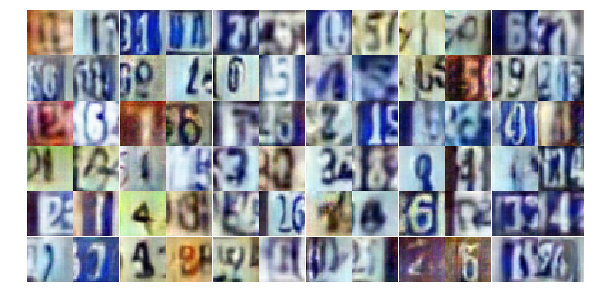

Epoch 19/25... Discriminator Loss: 0.5581... Generator Loss: 1.1817
Epoch 19/25... Discriminator Loss: 0.8961... Generator Loss: 0.7132
Epoch 19/25... Discriminator Loss: 0.5869... Generator Loss: 1.8898
Epoch 19/25... Discriminator Loss: 1.6066... Generator Loss: 0.3445
Epoch 19/25... Discriminator Loss: 0.5805... Generator Loss: 1.8829
Epoch 19/25... Discriminator Loss: 0.7914... Generator Loss: 1.1069
Epoch 19/25... Discriminator Loss: 1.7302... Generator Loss: 0.3308
Epoch 19/25... Discriminator Loss: 0.6012... Generator Loss: 1.2020
Epoch 20/25... Discriminator Loss: 0.7040... Generator Loss: 1.0426
Epoch 20/25... Discriminator Loss: 0.6085... Generator Loss: 1.1874


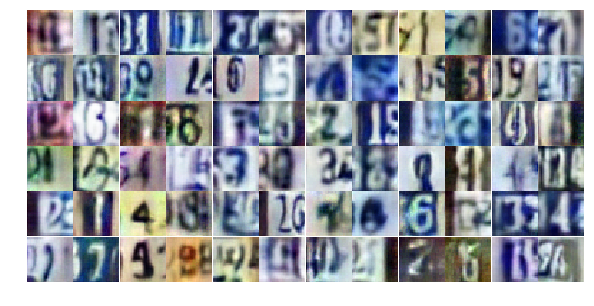

Epoch 20/25... Discriminator Loss: 0.6220... Generator Loss: 1.0895
Epoch 20/25... Discriminator Loss: 1.0450... Generator Loss: 0.6373
Epoch 20/25... Discriminator Loss: 1.0681... Generator Loss: 0.6418
Epoch 20/25... Discriminator Loss: 0.9924... Generator Loss: 0.7218
Epoch 20/25... Discriminator Loss: 0.4464... Generator Loss: 1.5430
Epoch 20/25... Discriminator Loss: 0.6333... Generator Loss: 1.0769
Epoch 20/25... Discriminator Loss: 0.8009... Generator Loss: 0.7964
Epoch 20/25... Discriminator Loss: 0.8912... Generator Loss: 0.8899
Epoch 20/25... Discriminator Loss: 0.7727... Generator Loss: 0.9030
Epoch 20/25... Discriminator Loss: 0.7326... Generator Loss: 0.9267


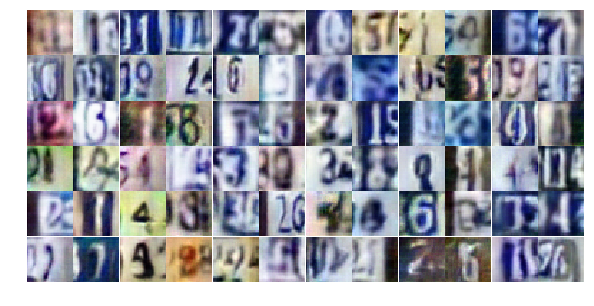

Epoch 20/25... Discriminator Loss: 1.0526... Generator Loss: 0.6854
Epoch 20/25... Discriminator Loss: 0.8927... Generator Loss: 0.7730
Epoch 20/25... Discriminator Loss: 0.6672... Generator Loss: 1.1775
Epoch 20/25... Discriminator Loss: 1.0658... Generator Loss: 0.6244
Epoch 20/25... Discriminator Loss: 0.9758... Generator Loss: 0.7101
Epoch 20/25... Discriminator Loss: 1.2725... Generator Loss: 0.4896
Epoch 20/25... Discriminator Loss: 1.3042... Generator Loss: 0.5164
Epoch 20/25... Discriminator Loss: 0.5822... Generator Loss: 1.5871
Epoch 20/25... Discriminator Loss: 0.6415... Generator Loss: 1.0562
Epoch 20/25... Discriminator Loss: 1.3797... Generator Loss: 0.4320


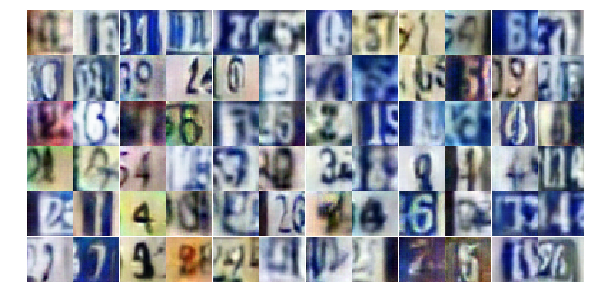

Epoch 20/25... Discriminator Loss: 0.6783... Generator Loss: 0.9369
Epoch 20/25... Discriminator Loss: 0.9901... Generator Loss: 0.6830
Epoch 20/25... Discriminator Loss: 0.2265... Generator Loss: 2.0403
Epoch 20/25... Discriminator Loss: 1.1118... Generator Loss: 0.5495
Epoch 20/25... Discriminator Loss: 0.5925... Generator Loss: 1.3268
Epoch 20/25... Discriminator Loss: 0.3743... Generator Loss: 2.9064
Epoch 20/25... Discriminator Loss: 0.5923... Generator Loss: 1.3159
Epoch 20/25... Discriminator Loss: 1.9565... Generator Loss: 0.2259
Epoch 20/25... Discriminator Loss: 1.1391... Generator Loss: 0.5327
Epoch 20/25... Discriminator Loss: 0.4270... Generator Loss: 1.3592


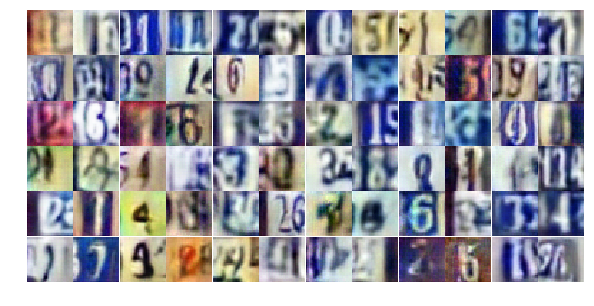

Epoch 20/25... Discriminator Loss: 0.8924... Generator Loss: 0.7594
Epoch 20/25... Discriminator Loss: 0.6431... Generator Loss: 1.0265
Epoch 20/25... Discriminator Loss: 1.9976... Generator Loss: 4.5015
Epoch 20/25... Discriminator Loss: 0.5611... Generator Loss: 1.7562
Epoch 20/25... Discriminator Loss: 1.0162... Generator Loss: 0.6581
Epoch 20/25... Discriminator Loss: 0.5863... Generator Loss: 1.1623
Epoch 20/25... Discriminator Loss: 0.6364... Generator Loss: 1.8083
Epoch 20/25... Discriminator Loss: 0.8862... Generator Loss: 0.8019
Epoch 20/25... Discriminator Loss: 0.7502... Generator Loss: 1.0864
Epoch 20/25... Discriminator Loss: 0.6977... Generator Loss: 0.9773


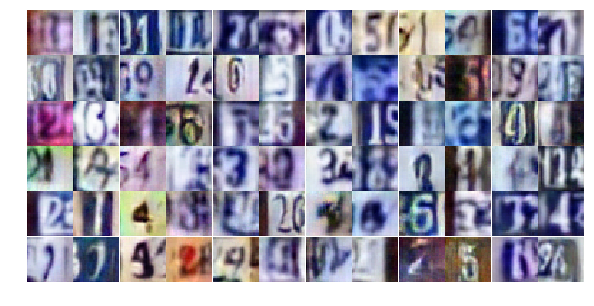

Epoch 20/25... Discriminator Loss: 1.3990... Generator Loss: 0.4468
Epoch 20/25... Discriminator Loss: 0.7160... Generator Loss: 0.9509
Epoch 20/25... Discriminator Loss: 1.2835... Generator Loss: 1.7865
Epoch 20/25... Discriminator Loss: 1.1812... Generator Loss: 0.9310
Epoch 20/25... Discriminator Loss: 0.9037... Generator Loss: 0.8276
Epoch 20/25... Discriminator Loss: 0.8220... Generator Loss: 0.9205
Epoch 20/25... Discriminator Loss: 0.8801... Generator Loss: 0.8101
Epoch 20/25... Discriminator Loss: 0.4097... Generator Loss: 1.9300
Epoch 20/25... Discriminator Loss: 0.5763... Generator Loss: 1.5907
Epoch 20/25... Discriminator Loss: 0.5440... Generator Loss: 1.2984


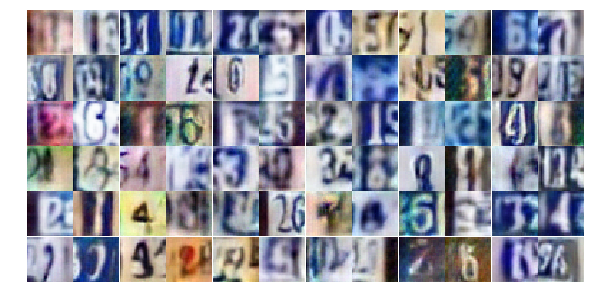

Epoch 20/25... Discriminator Loss: 0.5504... Generator Loss: 1.3430
Epoch 20/25... Discriminator Loss: 0.8451... Generator Loss: 0.8172
Epoch 20/25... Discriminator Loss: 0.4695... Generator Loss: 1.6590
Epoch 20/25... Discriminator Loss: 1.2199... Generator Loss: 0.5540
Epoch 20/25... Discriminator Loss: 0.5745... Generator Loss: 1.1558
Epoch 20/25... Discriminator Loss: 0.5285... Generator Loss: 1.2432
Epoch 21/25... Discriminator Loss: 0.9871... Generator Loss: 0.6504
Epoch 21/25... Discriminator Loss: 0.9696... Generator Loss: 0.7827
Epoch 21/25... Discriminator Loss: 1.6428... Generator Loss: 0.3239
Epoch 21/25... Discriminator Loss: 1.0126... Generator Loss: 0.6865


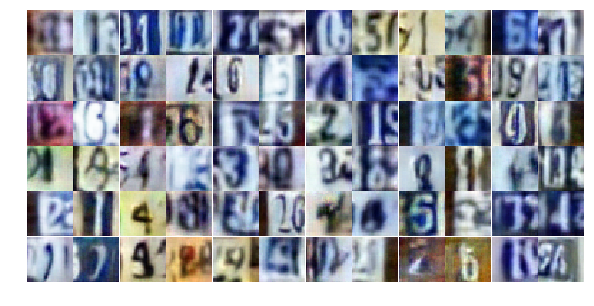

Epoch 21/25... Discriminator Loss: 0.8109... Generator Loss: 0.7928
Epoch 21/25... Discriminator Loss: 1.3830... Generator Loss: 0.5442
Epoch 21/25... Discriminator Loss: 0.3591... Generator Loss: 1.7691
Epoch 21/25... Discriminator Loss: 0.4445... Generator Loss: 1.5488
Epoch 21/25... Discriminator Loss: 0.5780... Generator Loss: 2.5298
Epoch 21/25... Discriminator Loss: 0.3718... Generator Loss: 1.7879
Epoch 21/25... Discriminator Loss: 0.5812... Generator Loss: 1.1623
Epoch 21/25... Discriminator Loss: 0.9463... Generator Loss: 0.6996
Epoch 21/25... Discriminator Loss: 0.5731... Generator Loss: 1.2144
Epoch 21/25... Discriminator Loss: 1.0526... Generator Loss: 0.6593


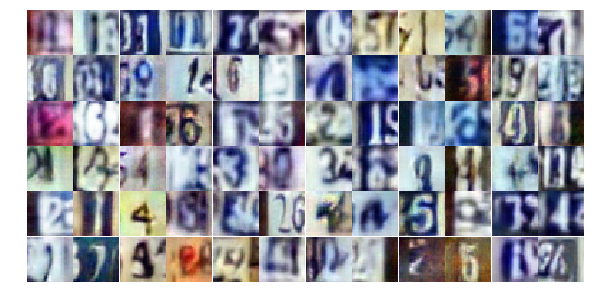

Epoch 21/25... Discriminator Loss: 0.4857... Generator Loss: 1.2767
Epoch 21/25... Discriminator Loss: 0.5977... Generator Loss: 1.1054
Epoch 21/25... Discriminator Loss: 2.0215... Generator Loss: 0.2373
Epoch 21/25... Discriminator Loss: 0.8955... Generator Loss: 0.8693
Epoch 21/25... Discriminator Loss: 0.6289... Generator Loss: 1.2686
Epoch 21/25... Discriminator Loss: 1.0716... Generator Loss: 0.6300
Epoch 21/25... Discriminator Loss: 0.9710... Generator Loss: 0.6806
Epoch 21/25... Discriminator Loss: 0.4175... Generator Loss: 1.4730
Epoch 21/25... Discriminator Loss: 0.4105... Generator Loss: 1.7231
Epoch 21/25... Discriminator Loss: 0.8290... Generator Loss: 0.8555


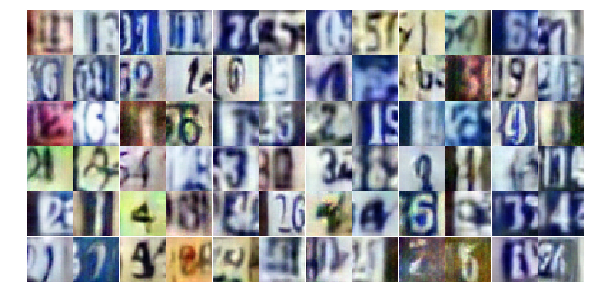

Epoch 21/25... Discriminator Loss: 1.1653... Generator Loss: 0.5705
Epoch 21/25... Discriminator Loss: 0.3039... Generator Loss: 1.8447
Epoch 21/25... Discriminator Loss: 0.6094... Generator Loss: 1.2743
Epoch 21/25... Discriminator Loss: 0.6832... Generator Loss: 1.1711
Epoch 21/25... Discriminator Loss: 0.9507... Generator Loss: 0.7450
Epoch 21/25... Discriminator Loss: 0.6054... Generator Loss: 1.2975
Epoch 21/25... Discriminator Loss: 0.4710... Generator Loss: 1.2960
Epoch 21/25... Discriminator Loss: 0.9939... Generator Loss: 0.7164
Epoch 21/25... Discriminator Loss: 1.0959... Generator Loss: 0.5430
Epoch 21/25... Discriminator Loss: 1.9394... Generator Loss: 0.3220


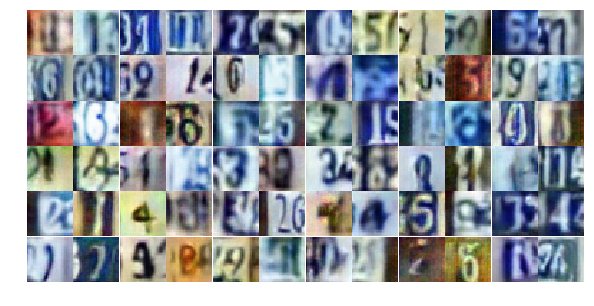

Epoch 21/25... Discriminator Loss: 0.8656... Generator Loss: 1.3171
Epoch 21/25... Discriminator Loss: 0.8938... Generator Loss: 0.7477
Epoch 21/25... Discriminator Loss: 1.0769... Generator Loss: 0.6672
Epoch 21/25... Discriminator Loss: 0.6925... Generator Loss: 0.9800
Epoch 21/25... Discriminator Loss: 0.6180... Generator Loss: 1.0561
Epoch 21/25... Discriminator Loss: 0.6198... Generator Loss: 1.2470
Epoch 21/25... Discriminator Loss: 1.1914... Generator Loss: 0.5573
Epoch 21/25... Discriminator Loss: 1.4880... Generator Loss: 0.3853
Epoch 21/25... Discriminator Loss: 0.7835... Generator Loss: 0.8742
Epoch 21/25... Discriminator Loss: 0.2209... Generator Loss: 2.9472


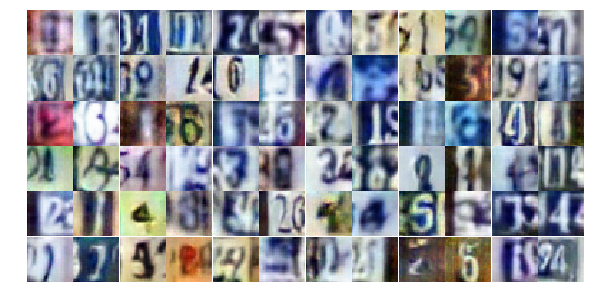

Epoch 21/25... Discriminator Loss: 0.8613... Generator Loss: 0.7844
Epoch 21/25... Discriminator Loss: 0.9982... Generator Loss: 0.6076
Epoch 21/25... Discriminator Loss: 0.5246... Generator Loss: 1.3149
Epoch 21/25... Discriminator Loss: 0.8941... Generator Loss: 0.8688
Epoch 21/25... Discriminator Loss: 0.4149... Generator Loss: 1.7486
Epoch 21/25... Discriminator Loss: 0.6787... Generator Loss: 1.0106
Epoch 21/25... Discriminator Loss: 0.6210... Generator Loss: 1.0995
Epoch 21/25... Discriminator Loss: 0.6423... Generator Loss: 1.2276
Epoch 21/25... Discriminator Loss: 1.6119... Generator Loss: 0.3095
Epoch 21/25... Discriminator Loss: 0.8645... Generator Loss: 1.2457


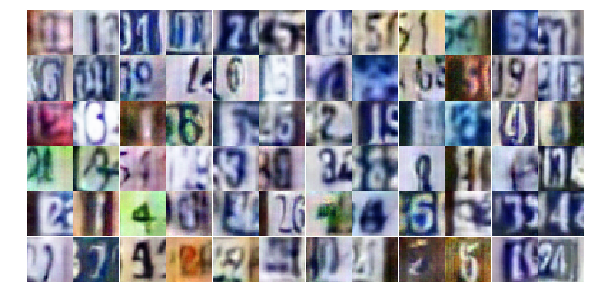

Epoch 21/25... Discriminator Loss: 0.6467... Generator Loss: 1.1320
Epoch 21/25... Discriminator Loss: 0.6428... Generator Loss: 2.0890
Epoch 21/25... Discriminator Loss: 0.6902... Generator Loss: 1.5310
Epoch 22/25... Discriminator Loss: 0.9519... Generator Loss: 2.4116
Epoch 22/25... Discriminator Loss: 0.7927... Generator Loss: 1.0618
Epoch 22/25... Discriminator Loss: 0.7402... Generator Loss: 1.1238
Epoch 22/25... Discriminator Loss: 0.6347... Generator Loss: 1.0423
Epoch 22/25... Discriminator Loss: 0.4676... Generator Loss: 1.3907
Epoch 22/25... Discriminator Loss: 1.0379... Generator Loss: 0.6692
Epoch 22/25... Discriminator Loss: 0.8243... Generator Loss: 0.8228


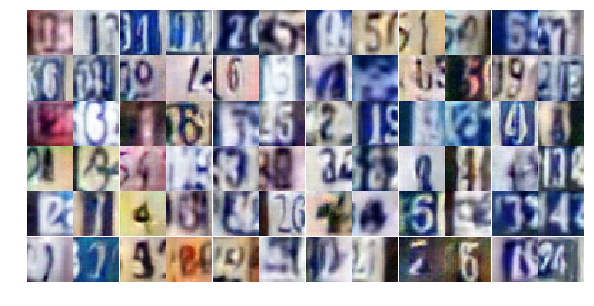

Epoch 22/25... Discriminator Loss: 0.4393... Generator Loss: 1.8334
Epoch 22/25... Discriminator Loss: 0.8487... Generator Loss: 0.9334
Epoch 22/25... Discriminator Loss: 1.2547... Generator Loss: 0.5354
Epoch 22/25... Discriminator Loss: 0.7836... Generator Loss: 0.8164
Epoch 22/25... Discriminator Loss: 0.6874... Generator Loss: 1.1535
Epoch 22/25... Discriminator Loss: 0.6226... Generator Loss: 1.3228
Epoch 22/25... Discriminator Loss: 0.6044... Generator Loss: 1.2244
Epoch 22/25... Discriminator Loss: 0.4419... Generator Loss: 1.7791
Epoch 22/25... Discriminator Loss: 0.6168... Generator Loss: 1.0695
Epoch 22/25... Discriminator Loss: 1.4809... Generator Loss: 0.3599


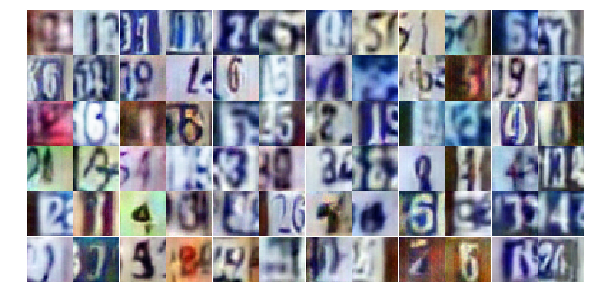

Epoch 22/25... Discriminator Loss: 0.5582... Generator Loss: 2.0959
Epoch 22/25... Discriminator Loss: 0.4163... Generator Loss: 1.9949
Epoch 22/25... Discriminator Loss: 1.4186... Generator Loss: 0.4209
Epoch 22/25... Discriminator Loss: 0.5882... Generator Loss: 1.1906
Epoch 22/25... Discriminator Loss: 0.4188... Generator Loss: 1.6817
Epoch 22/25... Discriminator Loss: 0.7393... Generator Loss: 0.9246
Epoch 22/25... Discriminator Loss: 0.4150... Generator Loss: 1.5495
Epoch 22/25... Discriminator Loss: 0.4509... Generator Loss: 1.5552
Epoch 22/25... Discriminator Loss: 0.5193... Generator Loss: 1.4036
Epoch 22/25... Discriminator Loss: 1.3929... Generator Loss: 0.4386


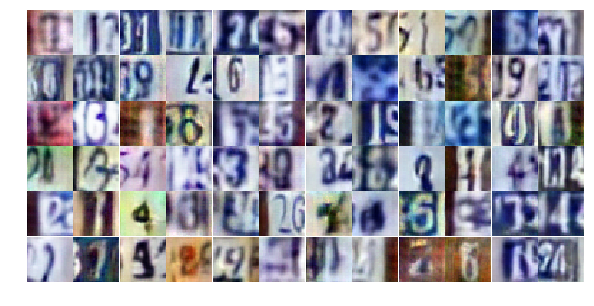

Epoch 22/25... Discriminator Loss: 0.5489... Generator Loss: 1.2389
Epoch 22/25... Discriminator Loss: 0.5360... Generator Loss: 1.2179
Epoch 22/25... Discriminator Loss: 0.7320... Generator Loss: 0.9326
Epoch 22/25... Discriminator Loss: 0.6567... Generator Loss: 1.0554
Epoch 22/25... Discriminator Loss: 0.8914... Generator Loss: 0.8024
Epoch 22/25... Discriminator Loss: 0.8417... Generator Loss: 0.8045
Epoch 22/25... Discriminator Loss: 1.4889... Generator Loss: 0.4557
Epoch 22/25... Discriminator Loss: 0.7190... Generator Loss: 3.1744
Epoch 22/25... Discriminator Loss: 1.0345... Generator Loss: 0.6765
Epoch 22/25... Discriminator Loss: 1.3122... Generator Loss: 0.5215


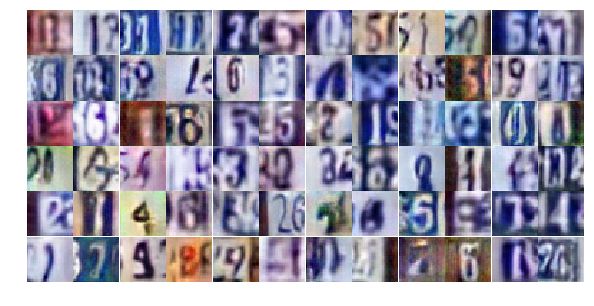

Epoch 22/25... Discriminator Loss: 0.6898... Generator Loss: 1.1246
Epoch 22/25... Discriminator Loss: 0.5306... Generator Loss: 1.4176
Epoch 22/25... Discriminator Loss: 0.3478... Generator Loss: 1.7346
Epoch 22/25... Discriminator Loss: 0.8371... Generator Loss: 0.7411
Epoch 22/25... Discriminator Loss: 0.5144... Generator Loss: 1.1588
Epoch 22/25... Discriminator Loss: 0.5289... Generator Loss: 1.1611
Epoch 22/25... Discriminator Loss: 0.5291... Generator Loss: 1.3840
Epoch 22/25... Discriminator Loss: 1.6771... Generator Loss: 0.2968
Epoch 22/25... Discriminator Loss: 1.5937... Generator Loss: 0.3488
Epoch 22/25... Discriminator Loss: 1.3850... Generator Loss: 4.2531


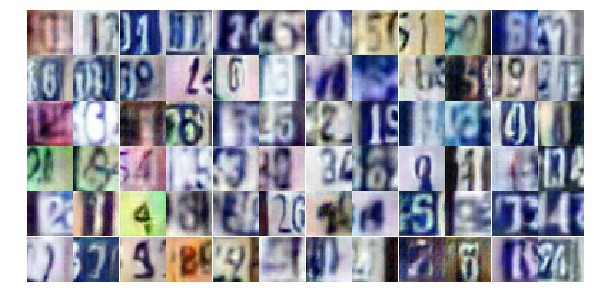

Epoch 22/25... Discriminator Loss: 2.0390... Generator Loss: 1.9433
Epoch 22/25... Discriminator Loss: 1.4803... Generator Loss: 0.7224
Epoch 22/25... Discriminator Loss: 0.8901... Generator Loss: 1.2681
Epoch 22/25... Discriminator Loss: 1.1188... Generator Loss: 0.6264
Epoch 22/25... Discriminator Loss: 0.7301... Generator Loss: 1.0222
Epoch 22/25... Discriminator Loss: 0.9713... Generator Loss: 0.8929
Epoch 22/25... Discriminator Loss: 0.9252... Generator Loss: 0.9225
Epoch 22/25... Discriminator Loss: 0.6265... Generator Loss: 1.0644
Epoch 22/25... Discriminator Loss: 0.9957... Generator Loss: 2.0867
Epoch 22/25... Discriminator Loss: 0.9693... Generator Loss: 0.7108


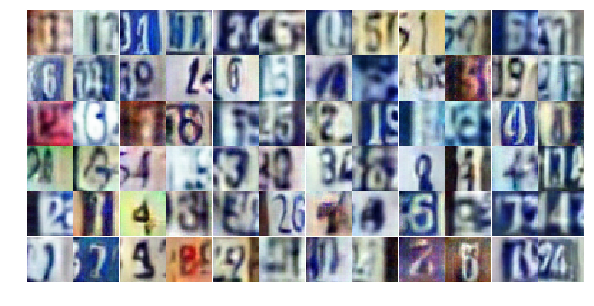

Epoch 23/25... Discriminator Loss: 0.6877... Generator Loss: 1.2215
Epoch 23/25... Discriminator Loss: 0.5435... Generator Loss: 1.3189
Epoch 23/25... Discriminator Loss: 0.7782... Generator Loss: 0.8802
Epoch 23/25... Discriminator Loss: 0.7207... Generator Loss: 0.9194
Epoch 23/25... Discriminator Loss: 0.7988... Generator Loss: 0.8073
Epoch 23/25... Discriminator Loss: 1.6637... Generator Loss: 0.3298
Epoch 23/25... Discriminator Loss: 1.0562... Generator Loss: 0.8278
Epoch 23/25... Discriminator Loss: 0.8472... Generator Loss: 0.7647
Epoch 23/25... Discriminator Loss: 0.7753... Generator Loss: 0.9067
Epoch 23/25... Discriminator Loss: 0.5325... Generator Loss: 1.2506


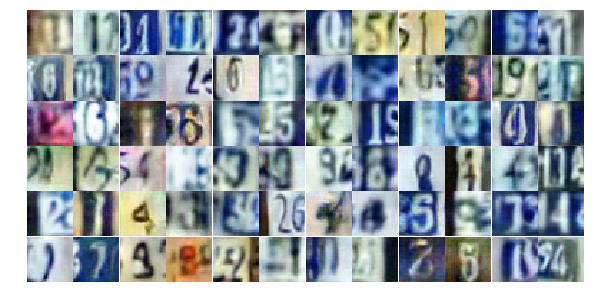

Epoch 23/25... Discriminator Loss: 0.4350... Generator Loss: 1.4726
Epoch 23/25... Discriminator Loss: 0.7313... Generator Loss: 0.9066
Epoch 23/25... Discriminator Loss: 0.7838... Generator Loss: 0.8712
Epoch 23/25... Discriminator Loss: 0.5710... Generator Loss: 1.2617
Epoch 23/25... Discriminator Loss: 0.3977... Generator Loss: 1.6785
Epoch 23/25... Discriminator Loss: 0.7215... Generator Loss: 1.0507
Epoch 23/25... Discriminator Loss: 1.0852... Generator Loss: 0.6339
Epoch 23/25... Discriminator Loss: 0.5976... Generator Loss: 1.1171
Epoch 23/25... Discriminator Loss: 0.7494... Generator Loss: 0.9172
Epoch 23/25... Discriminator Loss: 1.0035... Generator Loss: 0.6429


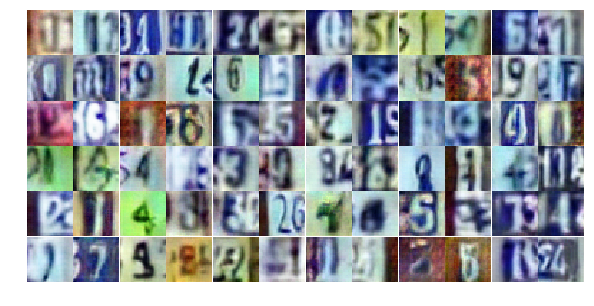

Epoch 23/25... Discriminator Loss: 0.9199... Generator Loss: 0.7116
Epoch 23/25... Discriminator Loss: 0.7236... Generator Loss: 1.0106
Epoch 23/25... Discriminator Loss: 1.4372... Generator Loss: 0.4370
Epoch 23/25... Discriminator Loss: 0.6865... Generator Loss: 1.1475
Epoch 23/25... Discriminator Loss: 0.4948... Generator Loss: 1.3987
Epoch 23/25... Discriminator Loss: 0.9682... Generator Loss: 0.6884
Epoch 23/25... Discriminator Loss: 0.6898... Generator Loss: 0.9725
Epoch 23/25... Discriminator Loss: 0.8262... Generator Loss: 0.8429
Epoch 23/25... Discriminator Loss: 0.5593... Generator Loss: 1.2154
Epoch 23/25... Discriminator Loss: 1.0321... Generator Loss: 0.8327


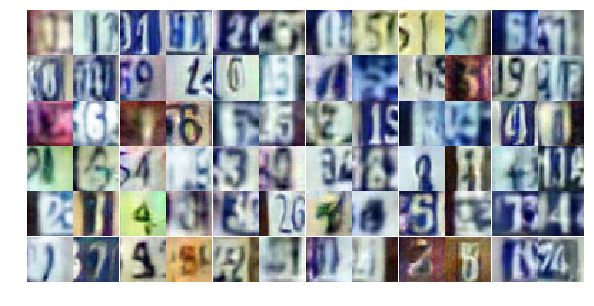

Epoch 23/25... Discriminator Loss: 0.8885... Generator Loss: 0.7016
Epoch 23/25... Discriminator Loss: 0.3136... Generator Loss: 1.8084
Epoch 23/25... Discriminator Loss: 0.5508... Generator Loss: 1.3055
Epoch 23/25... Discriminator Loss: 0.8534... Generator Loss: 0.7330
Epoch 23/25... Discriminator Loss: 0.5991... Generator Loss: 1.4425
Epoch 23/25... Discriminator Loss: 1.0438... Generator Loss: 0.6332
Epoch 23/25... Discriminator Loss: 1.0228... Generator Loss: 0.7798
Epoch 23/25... Discriminator Loss: 0.3419... Generator Loss: 1.8952
Epoch 23/25... Discriminator Loss: 0.4010... Generator Loss: 1.6276
Epoch 23/25... Discriminator Loss: 0.5727... Generator Loss: 1.1652


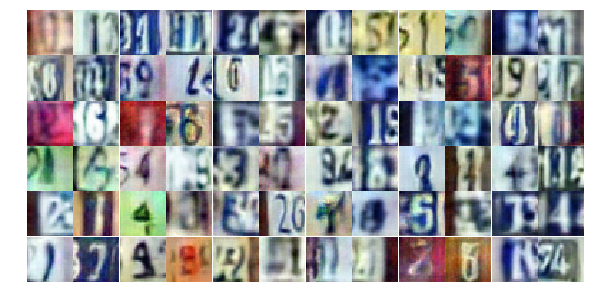

Epoch 23/25... Discriminator Loss: 0.6931... Generator Loss: 1.1930
Epoch 23/25... Discriminator Loss: 0.5091... Generator Loss: 1.3267
Epoch 23/25... Discriminator Loss: 1.1952... Generator Loss: 0.5870
Epoch 23/25... Discriminator Loss: 0.5487... Generator Loss: 1.2743
Epoch 23/25... Discriminator Loss: 1.8503... Generator Loss: 0.2611
Epoch 23/25... Discriminator Loss: 1.3607... Generator Loss: 0.5156
Epoch 23/25... Discriminator Loss: 0.6794... Generator Loss: 1.2774
Epoch 23/25... Discriminator Loss: 1.0768... Generator Loss: 0.6024
Epoch 23/25... Discriminator Loss: 0.9437... Generator Loss: 0.7245
Epoch 23/25... Discriminator Loss: 0.7436... Generator Loss: 0.9472


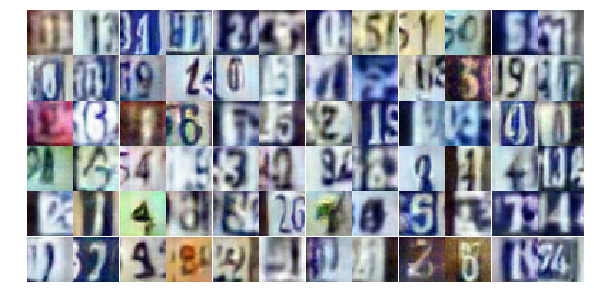

Epoch 23/25... Discriminator Loss: 0.8301... Generator Loss: 0.7790
Epoch 23/25... Discriminator Loss: 1.3883... Generator Loss: 0.4209
Epoch 23/25... Discriminator Loss: 0.9994... Generator Loss: 0.7244
Epoch 23/25... Discriminator Loss: 0.2537... Generator Loss: 2.4567
Epoch 23/25... Discriminator Loss: 1.1507... Generator Loss: 0.6434
Epoch 23/25... Discriminator Loss: 0.4335... Generator Loss: 1.5313
Epoch 23/25... Discriminator Loss: 0.9178... Generator Loss: 0.7375
Epoch 24/25... Discriminator Loss: 0.5980... Generator Loss: 1.1249
Epoch 24/25... Discriminator Loss: 0.9751... Generator Loss: 0.6911
Epoch 24/25... Discriminator Loss: 0.8850... Generator Loss: 0.8116


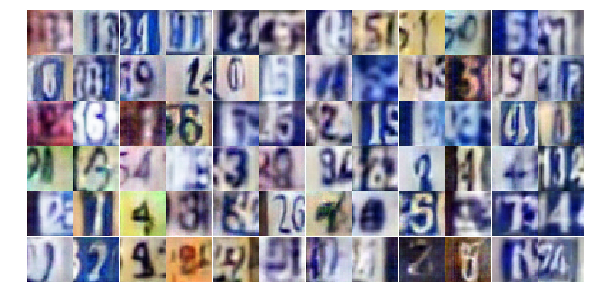

Epoch 24/25... Discriminator Loss: 0.6465... Generator Loss: 1.3437
Epoch 24/25... Discriminator Loss: 0.6931... Generator Loss: 1.0752
Epoch 24/25... Discriminator Loss: 0.7982... Generator Loss: 0.8308
Epoch 24/25... Discriminator Loss: 0.7414... Generator Loss: 2.2916
Epoch 24/25... Discriminator Loss: 3.1603... Generator Loss: 6.5410
Epoch 24/25... Discriminator Loss: 0.8216... Generator Loss: 0.9098
Epoch 24/25... Discriminator Loss: 0.6332... Generator Loss: 1.1675
Epoch 24/25... Discriminator Loss: 0.7770... Generator Loss: 0.9510
Epoch 24/25... Discriminator Loss: 0.3733... Generator Loss: 1.7520
Epoch 24/25... Discriminator Loss: 0.5251... Generator Loss: 1.4357


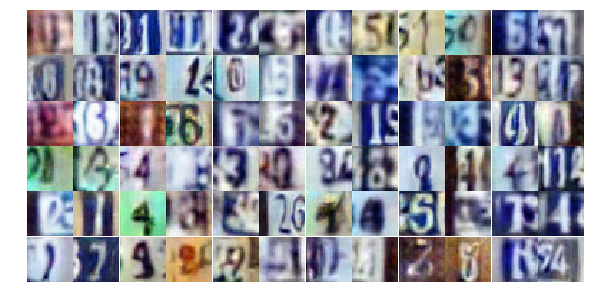

Epoch 24/25... Discriminator Loss: 1.2801... Generator Loss: 0.4735
Epoch 24/25... Discriminator Loss: 1.6155... Generator Loss: 0.3515
Epoch 24/25... Discriminator Loss: 1.0639... Generator Loss: 0.6590
Epoch 24/25... Discriminator Loss: 0.7227... Generator Loss: 0.8513
Epoch 24/25... Discriminator Loss: 0.6787... Generator Loss: 0.9025
Epoch 24/25... Discriminator Loss: 0.7325... Generator Loss: 0.9598
Epoch 24/25... Discriminator Loss: 0.6283... Generator Loss: 1.0400
Epoch 24/25... Discriminator Loss: 0.9395... Generator Loss: 0.7015
Epoch 24/25... Discriminator Loss: 0.8714... Generator Loss: 0.8370
Epoch 24/25... Discriminator Loss: 0.6096... Generator Loss: 1.0763


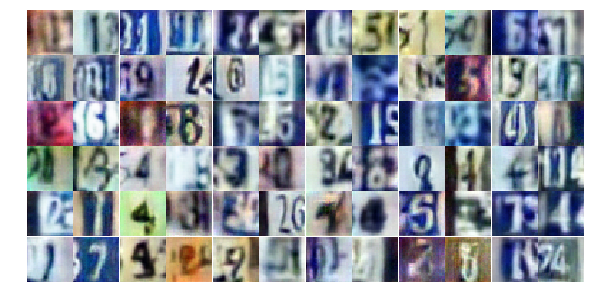

Epoch 24/25... Discriminator Loss: 0.5915... Generator Loss: 1.1543
Epoch 24/25... Discriminator Loss: 0.6659... Generator Loss: 1.2095
Epoch 24/25... Discriminator Loss: 0.3965... Generator Loss: 2.3015
Epoch 24/25... Discriminator Loss: 1.1187... Generator Loss: 0.5731
Epoch 24/25... Discriminator Loss: 0.6860... Generator Loss: 0.9600
Epoch 24/25... Discriminator Loss: 0.7341... Generator Loss: 0.8538
Epoch 24/25... Discriminator Loss: 0.6801... Generator Loss: 1.0109
Epoch 24/25... Discriminator Loss: 0.4400... Generator Loss: 1.5089
Epoch 24/25... Discriminator Loss: 0.7484... Generator Loss: 1.1337
Epoch 24/25... Discriminator Loss: 0.7613... Generator Loss: 0.9756


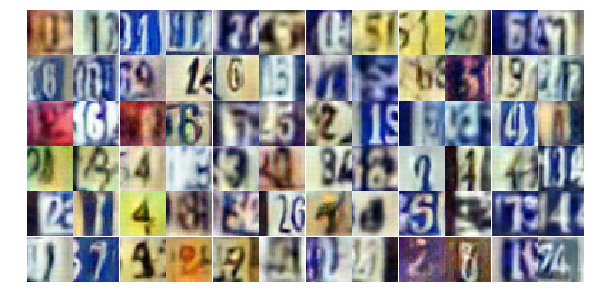

Epoch 24/25... Discriminator Loss: 0.4174... Generator Loss: 1.5062
Epoch 24/25... Discriminator Loss: 0.5566... Generator Loss: 1.1600
Epoch 24/25... Discriminator Loss: 0.6286... Generator Loss: 1.8445
Epoch 24/25... Discriminator Loss: 1.2363... Generator Loss: 0.5902
Epoch 24/25... Discriminator Loss: 1.1681... Generator Loss: 0.5346
Epoch 24/25... Discriminator Loss: 0.9273... Generator Loss: 0.6860
Epoch 24/25... Discriminator Loss: 1.3220... Generator Loss: 0.5668
Epoch 24/25... Discriminator Loss: 0.7148... Generator Loss: 0.9386
Epoch 24/25... Discriminator Loss: 0.5325... Generator Loss: 1.6807
Epoch 24/25... Discriminator Loss: 0.6213... Generator Loss: 1.0852


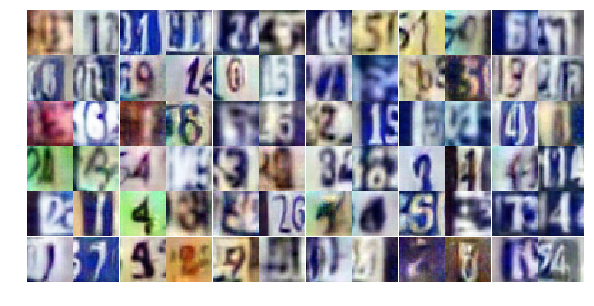

Epoch 24/25... Discriminator Loss: 0.8064... Generator Loss: 0.8590
Epoch 24/25... Discriminator Loss: 1.2672... Generator Loss: 0.5011
Epoch 24/25... Discriminator Loss: 0.8999... Generator Loss: 1.5915
Epoch 24/25... Discriminator Loss: 1.1395... Generator Loss: 0.6985
Epoch 24/25... Discriminator Loss: 1.5334... Generator Loss: 0.3769
Epoch 24/25... Discriminator Loss: 0.6623... Generator Loss: 1.0427
Epoch 24/25... Discriminator Loss: 0.8272... Generator Loss: 0.8628
Epoch 24/25... Discriminator Loss: 0.9661... Generator Loss: 0.6601
Epoch 24/25... Discriminator Loss: 0.7150... Generator Loss: 0.9246
Epoch 24/25... Discriminator Loss: 0.6975... Generator Loss: 1.1537


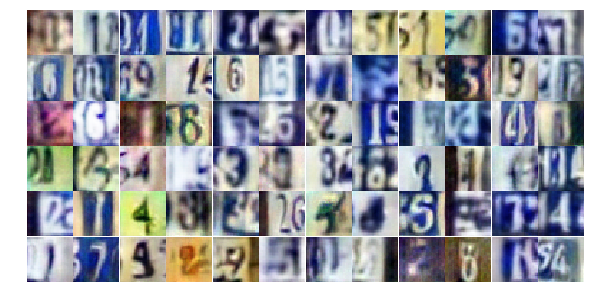

Epoch 24/25... Discriminator Loss: 0.8440... Generator Loss: 0.8347
Epoch 24/25... Discriminator Loss: 1.4528... Generator Loss: 0.4545
Epoch 24/25... Discriminator Loss: 0.6325... Generator Loss: 1.3543
Epoch 24/25... Discriminator Loss: 0.7922... Generator Loss: 1.0238
Epoch 24/25... Discriminator Loss: 1.2871... Generator Loss: 0.4916
Epoch 25/25... Discriminator Loss: 0.5948... Generator Loss: 1.2499
Epoch 25/25... Discriminator Loss: 0.7030... Generator Loss: 1.1622
Epoch 25/25... Discriminator Loss: 0.6253... Generator Loss: 1.0386
Epoch 25/25... Discriminator Loss: 0.7551... Generator Loss: 0.9229
Epoch 25/25... Discriminator Loss: 1.1557... Generator Loss: 0.5852


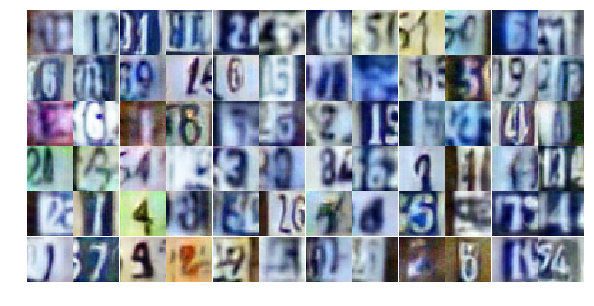

Epoch 25/25... Discriminator Loss: 1.3689... Generator Loss: 0.4356
Epoch 25/25... Discriminator Loss: 0.8088... Generator Loss: 1.0639
Epoch 25/25... Discriminator Loss: 0.7365... Generator Loss: 1.0039
Epoch 25/25... Discriminator Loss: 0.9612... Generator Loss: 0.7071
Epoch 25/25... Discriminator Loss: 0.4717... Generator Loss: 1.5707
Epoch 25/25... Discriminator Loss: 0.6432... Generator Loss: 1.0698
Epoch 25/25... Discriminator Loss: 0.4898... Generator Loss: 1.3847
Epoch 25/25... Discriminator Loss: 1.0411... Generator Loss: 0.7057
Epoch 25/25... Discriminator Loss: 0.4321... Generator Loss: 1.8979
Epoch 25/25... Discriminator Loss: 1.1162... Generator Loss: 0.5913


In [ ]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

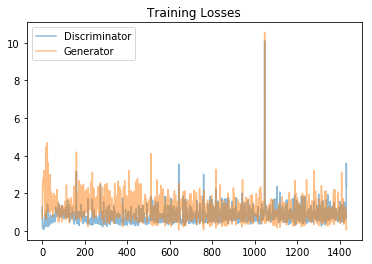

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

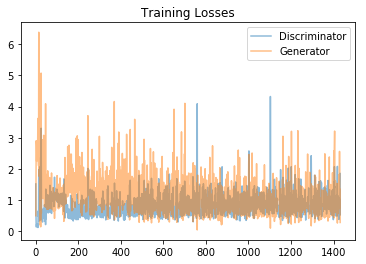

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

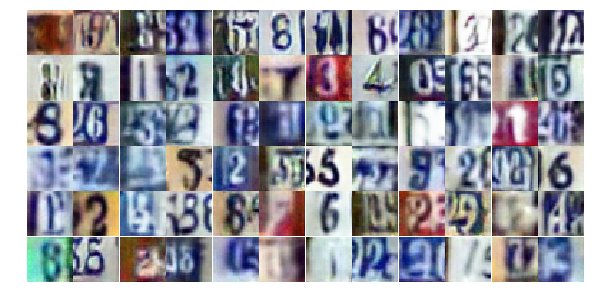

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

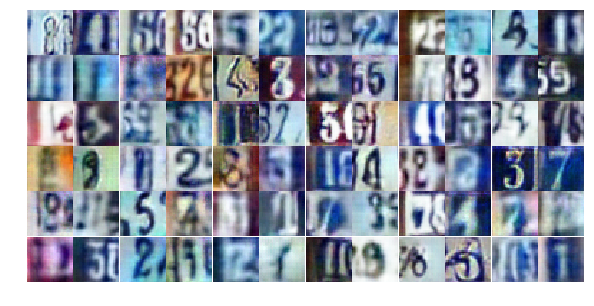

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))